# Business Understanding

The core business of a financial institution can be broadly classified as 
1. Lending
2. Borrowing. 

Lending generates revenue to the bank in the form of interest from customers with a certain degree of default risk involved. 

Borrowing, or rather attracting public’s savings into the bank is another source of revenue generation, which can be less risky than the former. Every bank offers term deposits to its customers from short-term to long-term time periods. For example, Kotak Mahindra Bank offers the following:

```
Get attractive returns on surplus funds for your organization. A tenure ranging from 7 days to 7 years provides you a wide range of investment options to suit your treasury needs.

Highlights and Features:
1. Our guaranteed fixed interest rates for a nominated term mean you know exactly what your investment is worth. It’s a secure option to let your money grow.
2. Loan facility to the extent of 85% of principal on a term deposit.
3. Attractive interest rates along with automatic rollovers to fuel your business ambitions and propel you towards long-term success.
```

Credits: Kotak Mahindra Bank Website ([Link](https://www.kotak.com/en/corporate/solutions/manage-my-transactions/account-maintenance/term-deposit.html))

**Note: The interests earned on the term deposits are component of the taxable income.**

- A bank usually invests the customer’s long-term deposits into riskier financial assets which can earn the better return than what they pay to their customer. 

- The customer is assured a risk-free return on his/her deposit. However, the return on the fixed-term deposit is better than the savings account as the customer is deprived off the rights to use the fund prior to the maturity unless one is ready to compensate the bank as per the pre-specified agreements on the particular term deposit scheme.

- Marketing campaigns to obtain a narrow retail segment interested in investing in term deposits is one of the core challenges faced by the banking industry today. With the years of overflowing liquidity and manual regulation over the banking investements becoming a thing of past, there is a process of scrutiny over the services offered by banks especially in the private sector today. 

- The industry has faced severe rise in the interest rates and regulation of the customers earnings, thus making the retail segment of banking a very competitive field.

A few of the demands by the various roles within the industry are as follows:

1. Product managers are looking for more accurate tools to manage deposit pricing as customers seek higher returns and the bank’s funding needs change;

2. Chief financial officers are demanding improved forecasting tools so they can better anticipate fluctuations in balances and funding costs as rates rise;

3. Treasurers and chief risk officers are under pressure to field a new generation of sophisticated stress testing tools to satisfy expanding regulatory expectations

4. Marketing managers need improved targeting algorithms and success metrics to match the right levels of spend with the right customers and prospects.

With advancement in data science and machine learning and availability of data, most banks are adapting to a data-driven decision. The dataset here consists of direct marketing by contacting the clients and assessing the success rate of sales made.

The result is a growing misalignment in deposit management. Within most banks, different teams use different tools that rely on different models with different metrics derived from different data.

Typically each deposit-related management group uses its own custom blend of internal and external data, accompanied by special labels, definitions and groupings that are difficult to rectify with other silos. Algorithms that seek to categorize customer behavior by households often diverge, especially when it comes to analyzing historical trend data. Meanwhile each silo uses its own database structure.

In this project, we apply machine learning algorithms to build a predictive model of the data set to provide a necessary suggestion for marketing campaign team. The goal is to predict whether a client will subscribe a term deposit (variable y) with the help of a given set of dependent variables. This is a real dataset collected from a Portuguese bank that used its own contact-center to do direct marketing campaigns to motivate and attract the clients for their term deposit scheme to enhance the business.

Key Aspects to understand:
Segment of the Population: To which segment of the population is the marketing campaign going to address and why? This aspect of the marketing campaign is extremely important since it will tell to which part of the population should most likely receive the message of the marketing campaign. 

Distribution channel to reach the customer's place: Implementing the most effective strategy in order to get the most out of this marketing campaign. What segment of the population should we address? Which instrument should we use to get our message out? (Ex: Telephones, Radio, TV, Social Media Etc.) 

Promotional Strategy: This is the way the strategy is going to be implemented and how are potential clients going to be address. This should be the last part of the marketing campaign analysis since there has to be an in-depth analysis of previous campaigns (If possible) in order to learn from previous mistakes and to determine how to make the marketing campaign much more effective.

Term deposit: It a deposit that a bank or a financial institurion offers with a fixed rate (often better than just opening deposit account) in which your money will be returned back at a specific maturity time.

# Data Understanding

The following features are present within the dataset:

1. id	Unique identifier for each sample in the dataset. Cannot be used for modelling
2. customer_age	Age of the Customer in years
3. job_type	Type of job of the customer
4. marital	Marital Status of the Custmer
5. education	Education Level of the Customer
6. default	Whether customer has Defaulted in Past
7. balance	Current Balance in the Customer's Bank
8. housing_loan	Has customer taken a Housing Loan
9. personal_loan	Has customer taken a Personal Loan
10. communication_type	Type of communication made by the bank with the customer
11. day_of_month	Day of month of the last contact made with customer
12. month	Month for the last contact made with customer
13. last_contact_duration	Last Contact duration made with the customer (in seconds)
14. num_contacts_in_campaign	Number of contacts made with the customer during the current campaign.
15. days_since_prev_campaign_contact	Number of days passed since customer was contacted in previous campaign.
16. num_contacts_prev_campaign	Number of contacts made with the customer during the previous campaign.
17. prev_campaign_outcome	Success or Failure in previous Campaign.
18. term_deposit_subscribed	(Target) Has the customer taken a term deposit ?



In [2]:
MzM1NjQxMDM1NDk0import pandas as pd
import numpy as np
from google.colab import drive
drive.mount("/content/gdrive")
import matplotlib.pyplot as plt
import seaborn as sns

import random
from scipy import stats

from plotly import tools
import plotly as py
import plotly.figure_factory as ff
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=True)

from sklearn.model_selection import train_test_split, KFold, StratifiedShuffleSplit,StratifiedKFold
from sklearn.preprocessing import OneHotEncoder, LabelEncoder, StandardScaler
from sklearn.metrics import roc_auc_score, roc_curve, f1_score
from sklearn.linear_model import LogisticRegression
from imblearn.over_sampling import SMOTE
from sklearn.pipeline import FeatureUnion
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV
from sklearn.pipeline import Pipeline

from xgboost import XGBClassifier
from sklearn.model_selection import train_test_split, KFold,  StratifiedShuffleSplit
from tqdm.notebook import tqdm ,tnrange
from lightgbm import LGBMClassifier
import warnings
warnings.filterwarnings('ignore')

SyntaxError: invalid syntax (<ipython-input-2-faf48ac6545c>, line 1)

In [ ]:
train = pd.read_csv("/content/gdrive/My Drive/Bank Term Deposit Prediction/Train.csv")
test = pd.read_csv("/content/gdrive/My Drive/Bank Term Deposit Prediction/Test.csv")

In [ ]:
train['source'] = 'train'
test['source'] = 'test'
data = pd.concat([train, test], axis=0).reset_index(drop = True)
data.shape

(45211, 19)

In [ ]:
def display_data(df):
  display(df.head())
  print("================")
  display(df.tail())
  print("================")
  print(df.shape)
display_data(data)

,id,customer_age,job_type,marital,education,default,balance,housing_loan,personal_loan,communication_type,day_of_month,month,last_contact_duration,num_contacts_in_campaign,days_since_prev_campaign_contact,num_contacts_prev_campaign,prev_campaign_outcome,term_deposit_subscribed,source
0,id_43823,28.0,management,single,tertiary,no,285.0,yes,no,unknown,26,jun,303.0,4.0,NaN,0,unknown,0.0,train
1,id_32289,34.0,blue-collar,married,secondary,no,934.0,no,yes,cellular,18,nov,143.0,2.0,132.0,1,other,0.0,train
2,id_10523,46.0,technician,married,secondary,no,656.0,no,no,cellular,5,feb,101.0,4.0,NaN,0,unknown,0.0,train
3,id_43951,34.0,services,single,secondary,no,2.0,yes,no,unknown,20,may,127.0,3.0,NaN,0,unknown,0.0,train
4,id_40992,41.0,blue-collar,married,primary,no,1352.0,yes,no,cellular,13,may,49.0,2.0,NaN,0,unknown,0.0,train


,id,customer_age,job_type,marital,education,default,balance,housing_loan,personal_loan,communication_type,day_of_month,month,last_contact_duration,num_contacts_in_campaign,days_since_prev_campaign_contact,num_contacts_prev_campaign,prev_campaign_outcome,term_deposit_subscribed,source
45206,id_42406,29.0,management,single,tertiary,no,717.0,yes,no,cellular,15,jun,94.0,1.0,NaN,0,unknown,NaN,test
45207,id_14483,NaN,blue-collar,married,secondary,no,604.0,yes,no,telephone,10,jul,155.0,1.0,NaN,0,unknown,NaN,test
45208,id_43066,45.0,blue-collar,married,primary,no,237.0,yes,no,unknown,16,may,231.0,4.0,NaN,0,unknown,NaN,test
45209,id_18375,52.0,admin.,married,primary,no,241.0,yes,no,cellular,13,may,243.0,2.0,299.0,5,failure,NaN,test
45210,id_12898,51.0,technician,married,unknown,no,368.0,yes,no,cellular,15,jul,102.0,2.0,NaN,0,unknown,NaN,test


(45211, 19)


In [ ]:
# Segregating Numerical and Categorical Columns

col_id = 'id'
col_y = 'term_deposit_subscribed'
src = 'source'
features = [c for c in train.columns if c not in [col_id, col_y, src]]
display(features)
cat_cols = data.select_dtypes(include=['object'])

# categorical variables
cat_cols = [c for c in features if c in cat_cols]
# numerical variables
num_cols = [n for n in features if n not in cat_cols]

display(cat_cols)
display(num_cols)

['customer_age',
 'job_type',
 'marital',
 'education',
 'default',
 'balance',
 'housing_loan',
 'personal_loan',
 'communication_type',
 'day_of_month',
 'month',
 'last_contact_duration',
 'num_contacts_in_campaign',
 'days_since_prev_campaign_contact',
 'num_contacts_prev_campaign',
 'prev_campaign_outcome']

['job_type',
 'marital',
 'education',
 'default',
 'housing_loan',
 'personal_loan',
 'communication_type',
 'month',
 'prev_campaign_outcome']

['customer_age',
 'balance',
 'day_of_month',
 'last_contact_duration',
 'num_contacts_in_campaign',
 'days_since_prev_campaign_contact',
 'num_contacts_prev_campaign']

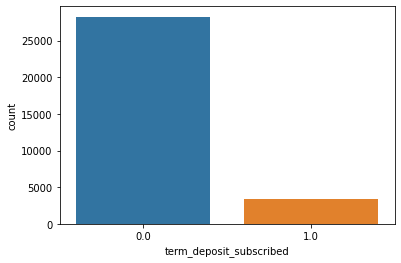

In [ ]:
sns.countplot(data["term_deposit_subscribed"])

We can observe that the dataset is highly imbalanced with the number of people not interested to subscribe to term deposits being very high compared to the number of subscribers. 

Therefore, we have to handle this class imbalance in order to make sure that there is no impact of the same on our model or else the generalization ability of the model on unseen data stands decreased.

We will try to explore the other features now.

In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 45211 entries, 0 to 45210
Data columns (total 19 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   id                                45211 non-null  object 
 1   customer_age                      44322 non-null  float64
 2   job_type                          45211 non-null  object 
 3   marital                           44980 non-null  object 
 4   education                         45211 non-null  object 
 5   default                           45211 non-null  object 
 6   balance                           44631 non-null  float64
 7   housing_loan                      45211 non-null  object 
 8   personal_loan                     44988 non-null  object 
 9   communication_type                45211 non-null  object 
 10  day_of_month                      45211 non-null  int64  
 11  month                             45211 non-null  object 
 12  last

In [ ]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 31647 entries, 0 to 31646
Data columns (total 19 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   id                                31647 non-null  object 
 1   customer_age                      31028 non-null  float64
 2   job_type                          31647 non-null  object 
 3   marital                           31497 non-null  object 
 4   education                         31647 non-null  object 
 5   default                           31647 non-null  object 
 6   balance                           31248 non-null  float64
 7   housing_loan                      31647 non-null  object 
 8   personal_loan                     31498 non-null  object 
 9   communication_type                31647 non-null  object 
 10  day_of_month                      31647 non-null  int64  
 11  month                             31647 non-null  object 
 12  last

In [ ]:
train.isna().sum()

id                                      0
customer_age                          619
job_type                                0
marital                               150
education                               0
default                                 0
balance                               399
housing_loan                            0
personal_loan                         149
communication_type                      0
day_of_month                            0
month                                   0
last_contact_duration                 311
num_contacts_in_campaign              112
days_since_prev_campaign_contact    25831
num_contacts_prev_campaign              0
prev_campaign_outcome                   0
term_deposit_subscribed                 0
source                                  0
dtype: int64

In [ ]:
test.isna().sum()

id                                      0
customer_age                          270
job_type                                0
marital                                81
education                               0
default                                 0
balance                               181
housing_loan                            0
personal_loan                          74
communication_type                      0
day_of_month                            0
month                                   0
last_contact_duration                 122
num_contacts_in_campaign               45
days_since_prev_campaign_contact    11123
num_contacts_prev_campaign              0
prev_campaign_outcome                   0
source                                  0
dtype: int64

In [ ]:
train.describe()

,customer_age,balance,day_of_month,last_contact_duration,num_contacts_in_campaign,days_since_prev_campaign_contact,num_contacts_prev_campaign,term_deposit_subscribed
count,31028.000000,31248.000000,31647.000000,31336.000000,31535.000000,5816.000000,31647.000000,31647.000000
mean,40.439216,1368.112615,15.818561,256.184038,2.776629,224.995186,0.591620,0.107246
std,10.751392,3085.342417,8.322970,256.181479,3.153293,114.991828,2.499675,0.309430
min,18.000000,-8020.000000,1.000000,0.000000,1.000000,1.000000,0.000000,0.000000
25%,32.000000,72.000000,8.000000,103.000000,1.000000,133.000000,0.000000,0.000000
50%,39.000000,449.000000,16.000000,179.000000,2.000000,195.000000,0.000000,0.000000
75%,48.000000,1413.000000,21.000000,315.250000,3.000000,329.000000,0.000000,0.000000
max,97.000000,102128.000000,31.000000,4900.000000,63.000000,871.000000,275.000000,1.000000


The mean age is 40 years with minimum and maximum values of age being 18 and 97 respectively and the mean balance is INR 1368 with a standard deviation of INR 3085 which is a large number indicating that the balance is spread equitably across the data.

The mean and standard deviation of previous call duration is almost equal meaning that there are a high number of observations below (Mean - Standard Deviation) which is equivalent to zero.

In [ ]:
train.corr(method='spearman')

,customer_age,balance,day_of_month,last_contact_duration,num_contacts_in_campaign,days_since_prev_campaign_contact,num_contacts_prev_campaign,term_deposit_subscribed
customer_age,1.000000,0.096030,-0.011817,-0.028291,0.035721,-0.086946,-0.015934,-0.002264
balance,0.096030,1.000000,0.000056,0.046502,-0.032744,-0.195038,0.078269,0.102610
day_of_month,-0.011817,0.000056,1.000000,-0.060713,0.141868,-0.078041,-0.090589,-0.028038
last_contact_duration,-0.028291,0.046502,-0.060713,1.000000,-0.106468,-0.045599,0.034811,0.349805
num_contacts_in_campaign,0.035721,-0.032744,0.141868,-0.106468,1.000000,0.079172,-0.109158,-0.080196
days_since_prev_campaign_contact,-0.086946,-0.195038,-0.078041,-0.045599,0.079172,1.000000,-0.104169,-0.195221
num_contacts_prev_campaign,-0.015934,0.078269,-0.090589,0.034811,-0.109158,-0.104169,1.000000,0.177729
term_deposit_subscribed,-0.002264,0.102610,-0.028038,0.349805,-0.080196,-0.195221,0.177729,1.000000


The last contact duration, customer balance and number of contacts in the previous campaign are positively correlated with the term deposit subscription status. However, only last contact duration has a significant correlation.

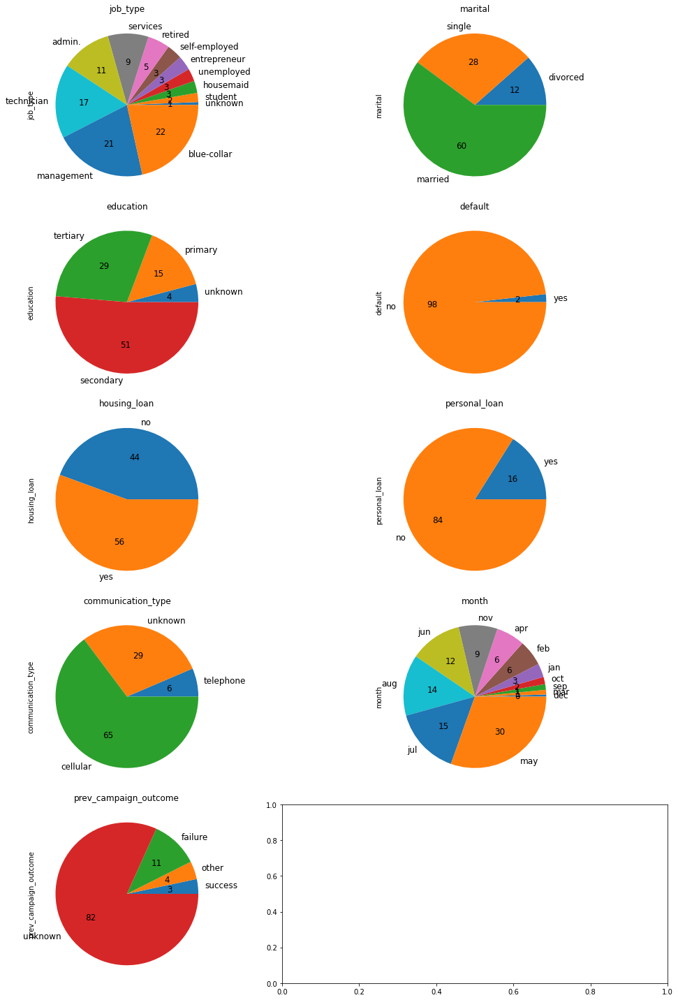

In [ ]:
def pie_chart(data, list_of_cols):
    fig, axes = plt.subplots(5,2, figsize=(15,20))
    axes = [ax for axes_row in axes for ax in axes_row]
    
    for i, c in enumerate(data[list_of_cols]):
        _ = data[c].value_counts()[::-1].plot(kind='pie',ax=axes[i], title=c, 
                                              autopct="%.0f", fontsize=12)
        _ = axes[i].set_label('')
        _ = plt.tight_layout()
pie_chart(data, cat_cols)

The following observations can be made on the data:
1. Management, Blue Collar and Technicians are the top 3 preferred job types in the data.
2. 60 percent of the people in the data are married and 28 percent of them are single.
3. Half of the people within the data have completed secondary education.
4. Only 2 percent of the people within data are defaulters.
5. Nearly half of the people have a housing loan and other half does not have any loan.
6. Only 16% of the people within data are having personal loan.
7. 65% of the people use cellular communication.
8. The months of May and July have maximum number of entries within data.
9. 11% of the previous campaign outcome is a failure, only 3% has been successful and 82% people do not have any data associated with it.

Based on our observations, we can create the following hypotheses:
1. Blue Collar job type persons are more likely to subscribe to term deposits than other jobs.
2. Married people are more likely to buy term deposits.
3. The people with secondary education have higher investments in term deposits.
4. The people who are defaulters are more likely to not buy term deposits.
5. People with no housing loan have more money to buy term deposits.
6. The people with personal loan are more likely to buy term deposits as they have more incentive to save.
7. May is the best month to advertise term deposits.

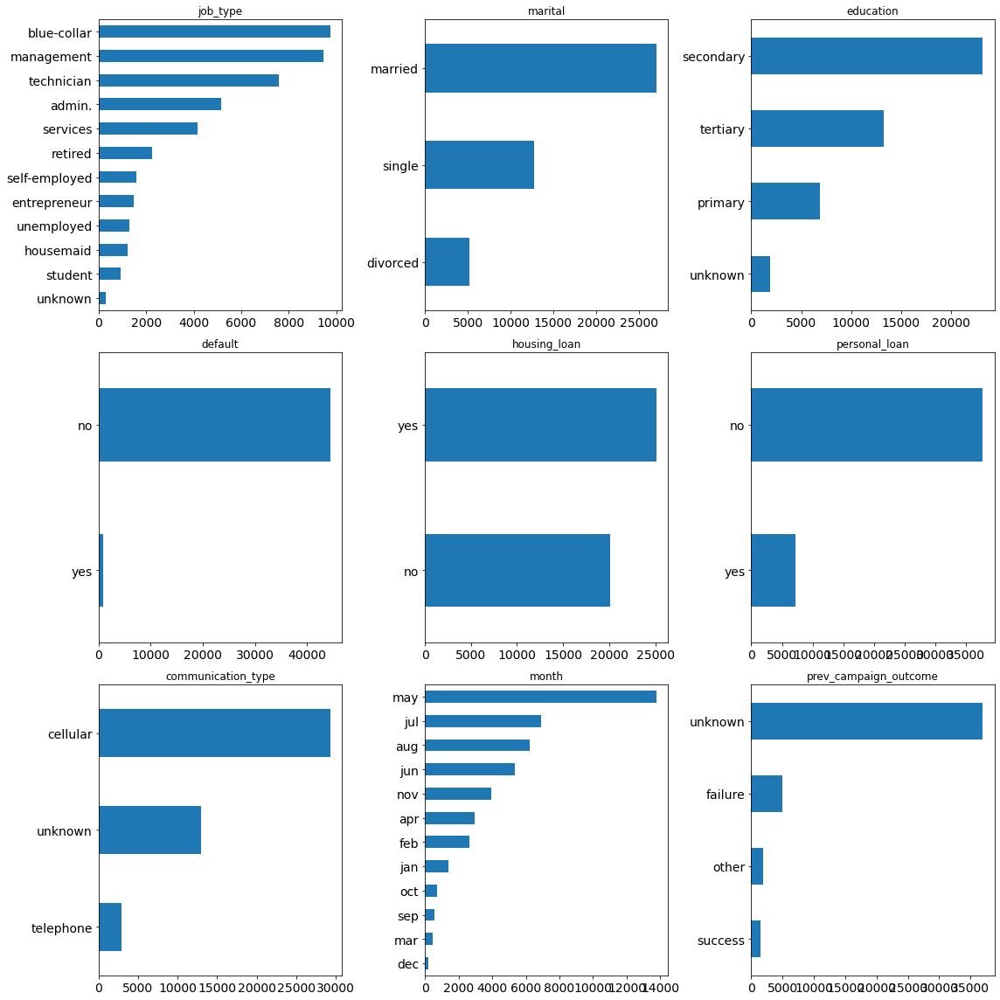

In [ ]:
def univariate_count(data, list_of_cols):
    fig, axes = plt.subplots(3, 3, figsize=(16, 16))
    axes = [ax for axes_row in axes for ax in axes_row]

    for i, c in enumerate(train[list_of_cols]):
        _ = data[c].value_counts()[::-1].plot(kind = 'barh', ax=axes[i], title=c, fontsize=14)
    
    _ = plt.tight_layout()

univariate_count(data, cat_cols)

Distribution of  customer_age
Skewness : 0.6633554104707464, Kurtosis : 0.3079426491375705


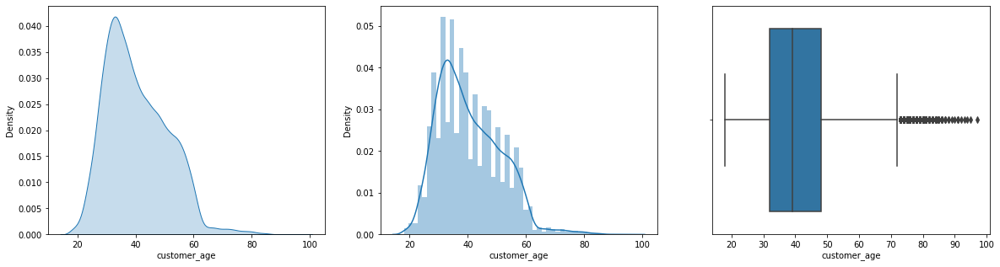

Distribution of  balance
Skewness : 8.087327690035934, Kurtosis : 133.28741119661424


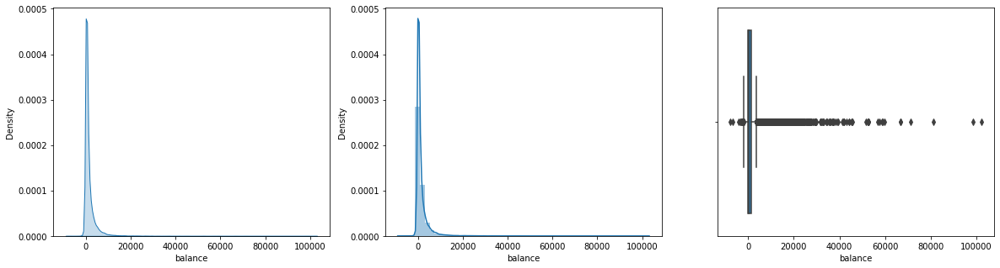

Distribution of  day_of_month
Skewness : 0.09307901402122407, Kurtosis : -1.0598973728286012


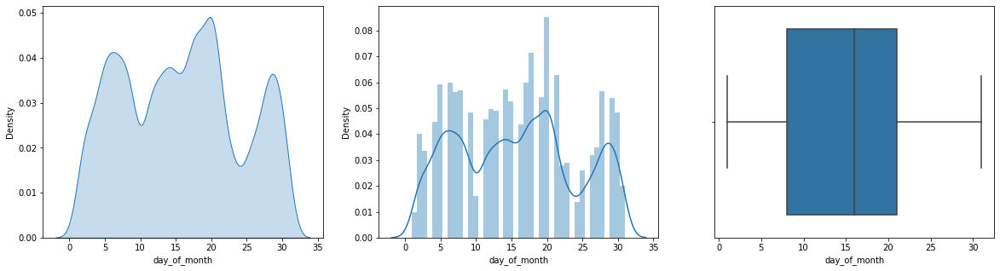

Distribution of  last_contact_duration
Skewness : 3.1336760544585096, Kurtosis : 18.081720644407078


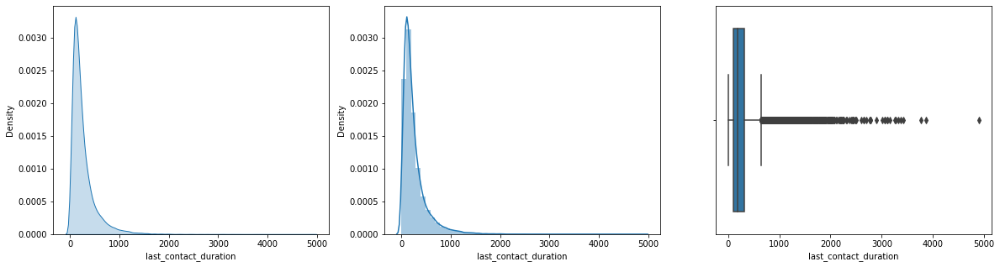

Distribution of  num_contacts_in_campaign
Skewness : 4.862436855548525, Kurtosis : 38.53556814919442


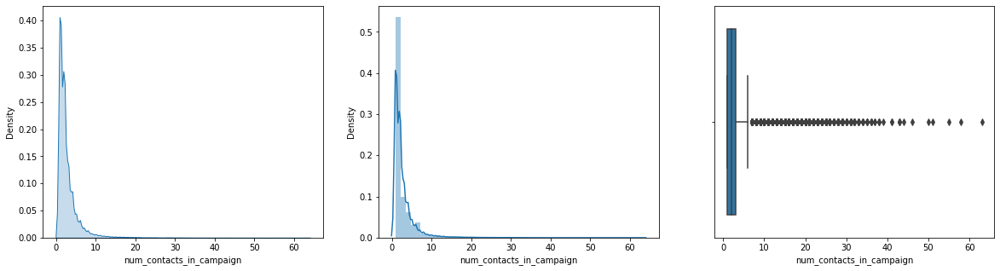

Distribution of  days_since_prev_campaign_contact
Skewness : 0.6931397093928039, Kurtosis : 1.5286825203029069


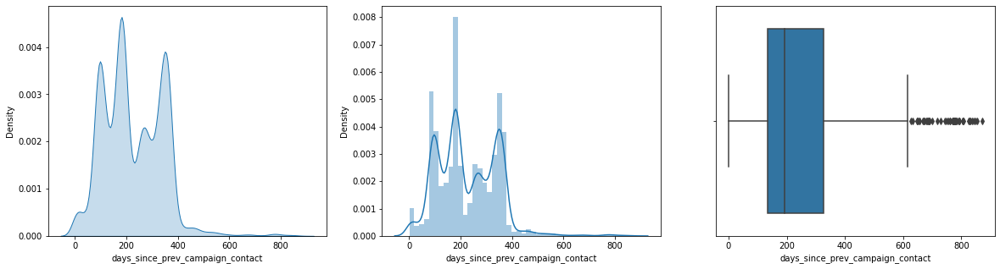

Distribution of  num_contacts_prev_campaign
Skewness : 41.84645447266289, Kurtosis : 4506.86066018326


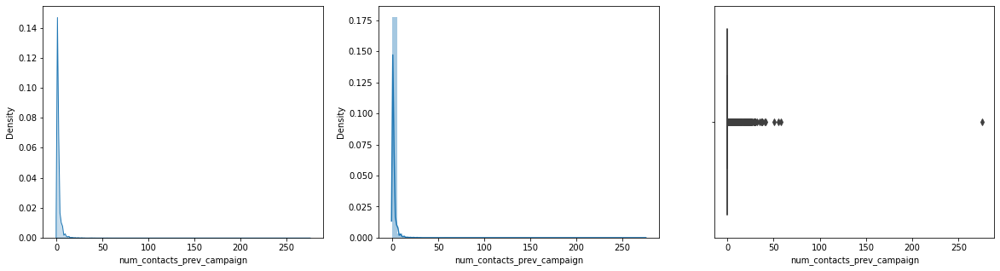

In [ ]:
def data_distribution(data, feature):
    
    plt.figure(figsize = (20,5))
    print("Distribution of ", feature)
    plt.subplot(1,3,1)
    sns.kdeplot(data[feature], shade=True)

    plt.subplot(1,3,2)
    sns.distplot(data[feature])

    plt.subplot(1,3,3)
    sns.boxplot(data[feature], orient = 'vertical')

    print("Skewness : {}, Kurtosis : {}".format(data[feature].skew(), data[feature].kurtosis()))
    plt.show()
for i in num_cols:
  data_distribution(data, i)

We can make the following observations from the data:
1. Customer Age is right skewed and Kurtosis is 0.3 which is less than 3 and hence it is a platykurtic distribution.
Kurtosis is a measure of whether the distribution is too peaked (a very narrow distribution with most of the responses in the center) and the value between 1 and -1 is acceptable as a rule of thumb. However, anything above 3 and lower than -3 are alarming and needs to be handled.
2. Balance is highly right skewed with Kurtosis=133 which means it is Leptokurtic Distribution (Kurtosis>3) which is extremely high and we will have to handle this.
3. The Day of the month is equally spread and we cannot make anything out of the distribution.

Other features are as it is very small in value and it is justified to have such observational values.

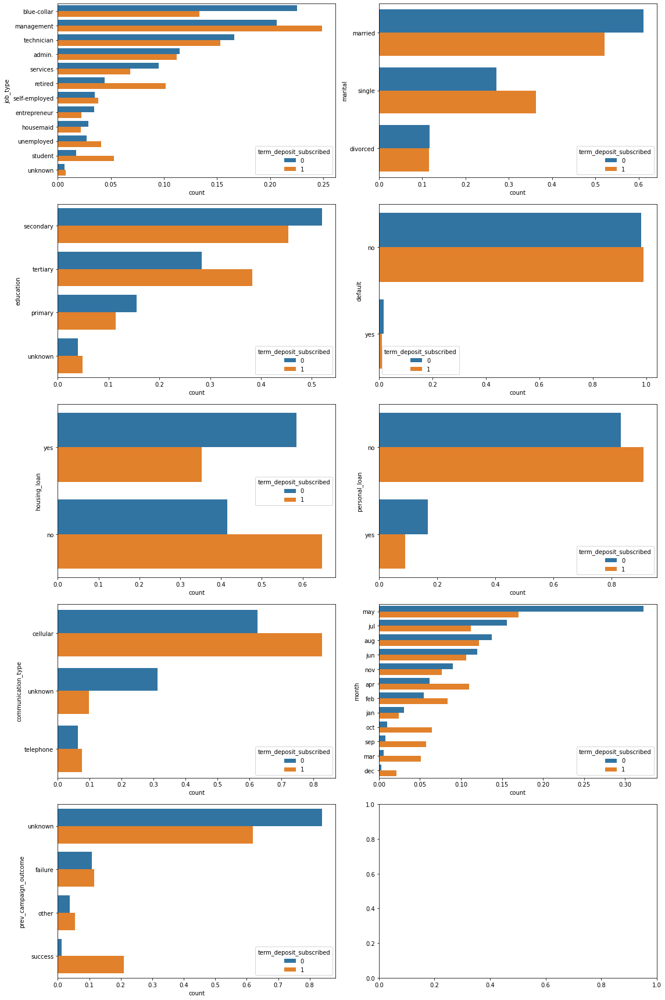

In [ ]:
def bivariate_count(data, list_of_cols, target):
    fig, axes = plt.subplots(5, 2, figsize=(16, 24))
    axes = [ax for axes_row in axes for ax in axes_row]

    for i, c in enumerate(data[list_of_cols]):
        fltr = train[target] == 0
        vc_a = train[fltr][c].value_counts(normalize=True).reset_index().rename({'index' : c, c: 'count'}, axis=1)

        vc_b = train[~fltr][c].value_counts(normalize=True).reset_index().rename({'index' : c, c: 'count'}, axis=1)

        vc_a[target] = 0
        vc_b[target] = 1

        df = pd.concat([vc_a, vc_b]).reset_index(drop = True)

        _ = sns.barplot(y = c, x = 'count', data =df , hue=target, ax=axes[i])
    
    _ = plt.tight_layout()
bivariate_count(data, cat_cols, col_y)

Based on our bivariate analysis, we will revisit our hypotheses. Reiterating the initial hypotheses based on univariate analysis:

1. Blue Collar job type persons are more likely to subscribe to term deposits than other jobs.
2. Married people are more likely to buy term deposits.
3. The people with secondary education have higher investments in term deposits.
4. The people who are defaulters are more likely to not buy term deposits.
5. People with no housing loan have more money to buy term deposits.
6. The people with personal loan are more likely to buy term deposits as they have more incentive to save.
7. May is the best month to advertise term deposits.

Let us try to evaluate further with bivariate analysis on the features to understand these hypotheses.

1. Technicians and management job types are more interested to invest in term deposits. Hence, our assumption that the blue collar job type is more interested in term deposits than others is incorrect.
2. There are more number of married people who are not interested in investing into term deposits, and singles are more interested in term deposit investments. Thus, our assumption of married people more interested in term deposits is also wrong.
3. Tertiary sector people are more interested into investing into term deposits.
4. There are almost equal number of defaulters and non-defaulters interested in investing as much as not interested in it. Thus, it is more of a uniform feature and our assumption is wrong.
5. People without housing loan are more interested in term deposits.
6. People without personal loans are more interested in term deposits.

Hence, in general we can say loan is negatively associated with term deposit susbcription.

7. There are more number of people not interested in term deposits in May than other months. Hence, our assumption is wrong. March, September, October, April and February are the months where people are more interested to invest into term deposit subscriptions.

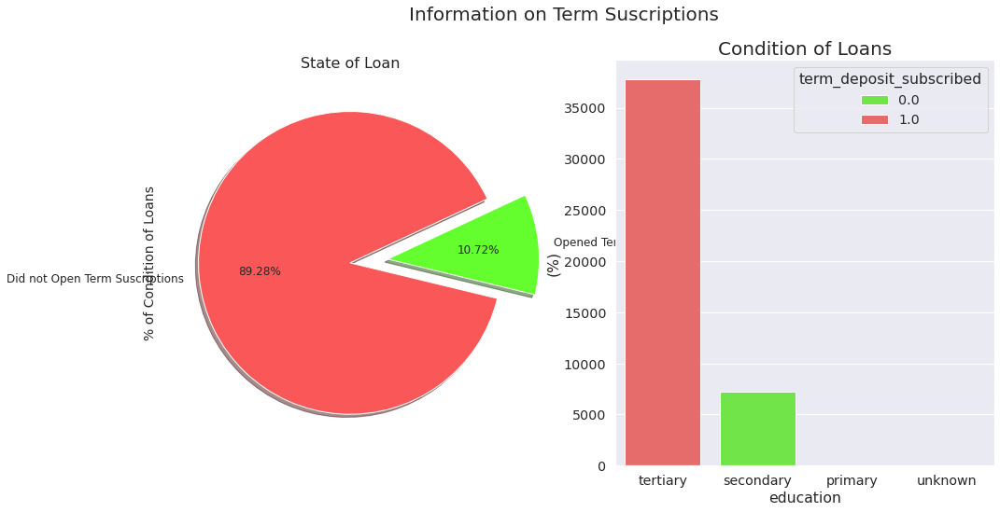

In [ ]:
f, ax = plt.subplots(1,2, figsize=(16,8))

colors = ["#FA5858", "#64FE2E"]
labels ="Did not Open Term Suscriptions", "Opened Term Suscriptions"

plt.suptitle('Information on Term Suscriptions', fontsize=20)

data["term_deposit_subscribed"].value_counts().plot.pie(explode=[0,0.25], autopct='%1.2f%%', ax=ax[0], shadow=True, colors=colors, 
                                             labels=labels, fontsize=12, startangle=25)


ax[0].set_title('State of Loan', fontsize=16)
ax[0].set_ylabel('% of Condition of Loans', fontsize=14)

sns.countplot('personal_loan', data=data, ax=ax[1], palette=colors)
ax[1].set_title('Condition of Loans', fontsize=20)
ax[1].set_xticklabels(['Good', 'Bad'], rotation='horizontal')
palette = ["#64FE2E", "#FA5858"]

sns.barplot(x="education", y="balance", hue="term_deposit_subscribed", data=data, palette=palette, estimator=lambda x: len(x) / len(data) * 100)
ax[1].set(ylabel="(%)")
ax[1].set_xticklabels(data["education"].unique(), rotation=0, rotation_mode="anchor")
plt.show()

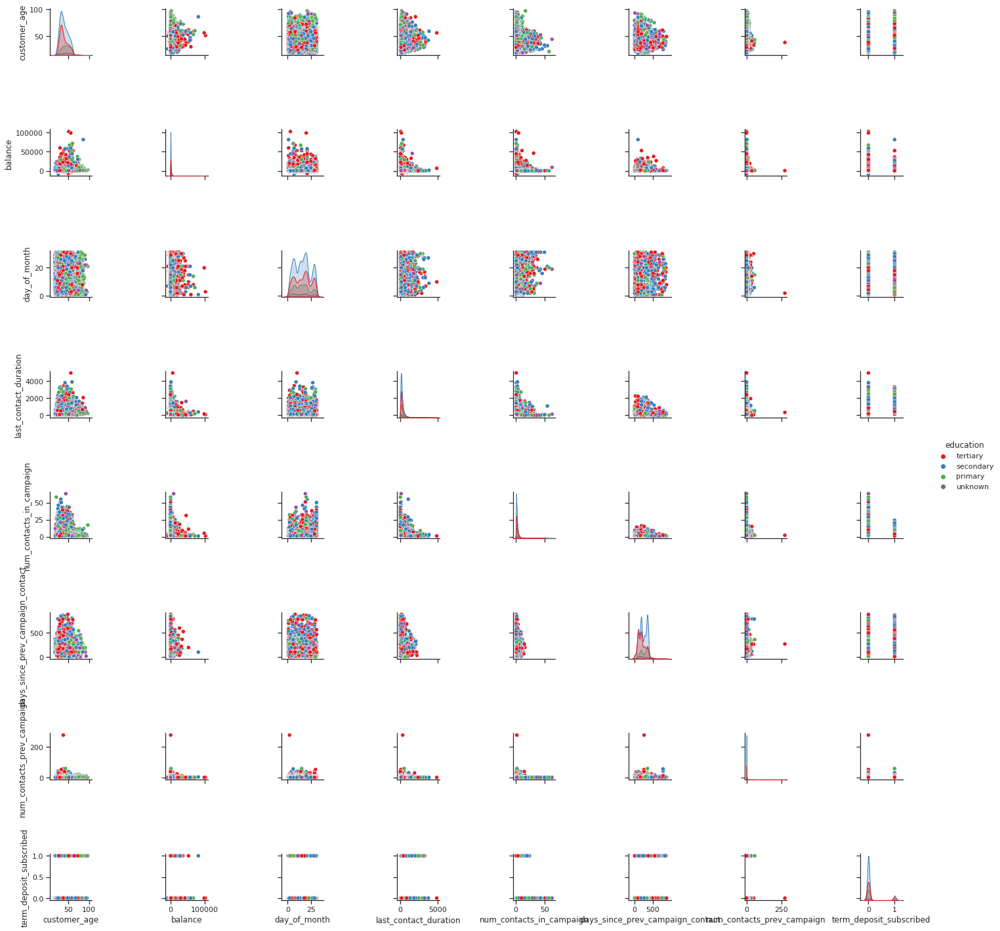

In [ ]:
sns.set(style="ticks")

sns.pairplot(data, hue="education", palette="Set1")
plt.show()

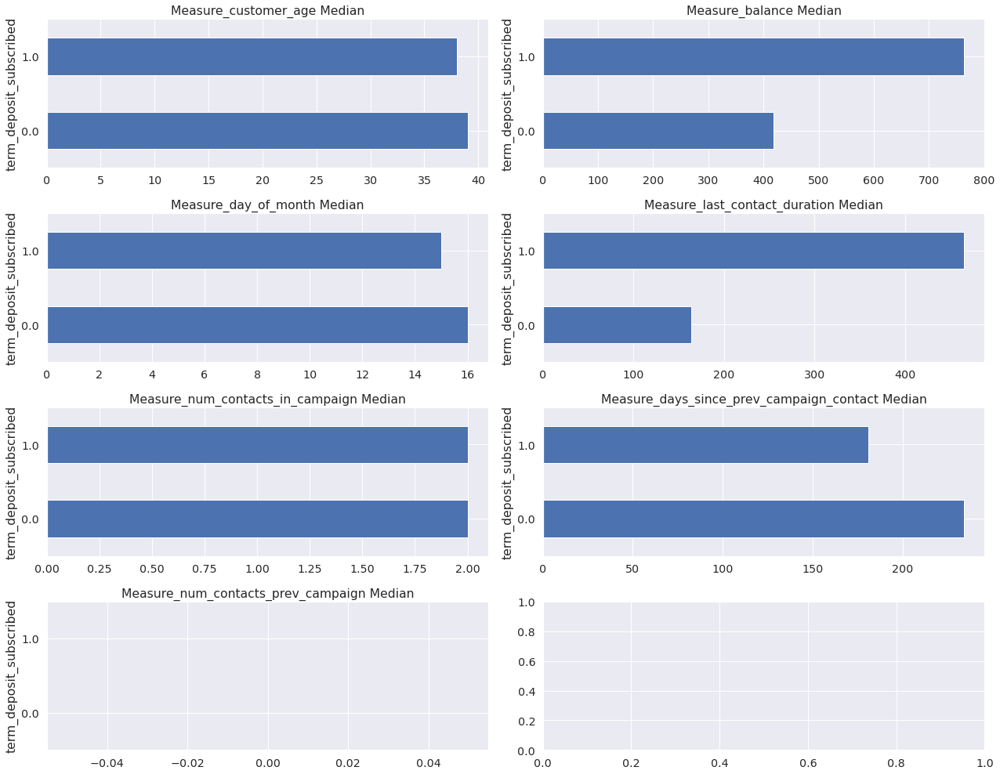

In [ ]:
def median_target_comparison(data, target, list_of_cols):
    sns.set(font_scale=1.3)
    fig, axes = plt.subplots(4, 2, figsize=(18, 14))
    axes = [ax for axes_row in axes for ax in axes_row]
    for i, c in enumerate(list_of_cols):
      plot = data.groupby(target)[c].median().plot(kind = 'barh', title=f'Measure_{c} Median', ax=axes[i])
    plt.tight_layout()
median_target_comparison(data, 'term_deposit_subscribed', num_cols)

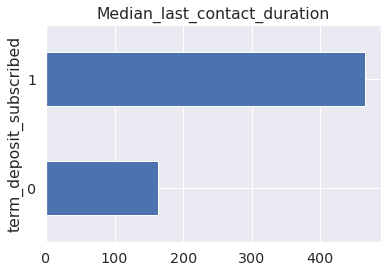

In [ ]:
_ = train.groupby(col_y)['last_contact_duration'].median().plot(kind = 'barh', title=f'Median_last_contact_duration')

In [ ]:
data.loc[data['job_type']=='unknown']

,id,customer_age,job_type,marital,education,default,balance,housing_loan,personal_loan,communication_type,day_of_month,month,last_contact_duration,num_contacts_in_campaign,days_since_prev_campaign_contact,num_contacts_prev_campaign,prev_campaign_outcome,term_deposit_subscribed,source
69,id_19178,55.0,unknown,married,primary,no,10.0,no,no,telephone,19,oct,258.0,2.0,NaN,0,unknown,0.0,train
280,id_6035,64.0,unknown,married,unknown,no,2795.0,no,no,telephone,9,sep,375.0,4.0,NaN,0,unknown,0.0,train
832,id_20033,60.0,unknown,married,unknown,no,1504.0,no,no,cellular,16,nov,295.0,1.0,104.0,2,failure,0.0,train
853,id_6089,54.0,unknown,married,tertiary,no,-2.0,no,no,unknown,16,may,410.0,3.0,NaN,0,unknown,0.0,train
862,id_10406,47.0,unknown,married,primary,no,40.0,no,no,unknown,11,jun,91.0,1.0,NaN,0,unknown,0.0,train
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
43664,id_27508,54.0,unknown,married,secondary,yes,-208.0,yes,no,unknown,3,jun,142.0,2.0,NaN,0,unknown,NaN,test
43668,id_36123,43.0,unknown,married,primary,no,582.0,yes,no,telephone,21,jul,99.0,3.0,NaN,0,unknown,NaN,test
43688,id_1812,41.0,unknown,married,unknown,no,218.0,no,no,cellular,26,aug,68.0,16.0,NaN,0,unknown,NaN,test
44184,id_31843,57.0,unknown,married,primary,no,1468.0,no,no,unknown,5,jun,64.0,NaN,NaN,0,unknown,NaN,test


Only 199 people are present without any jobs in the data

In [ ]:
data.loc[(data['job_type']=='unknown') & (data['source']=='train')]

,id,customer_age,job_type,marital,education,default,balance,housing_loan,personal_loan,communication_type,day_of_month,month,last_contact_duration,num_contacts_in_campaign,days_since_prev_campaign_contact,num_contacts_prev_campaign,prev_campaign_outcome,term_deposit_subscribed,source
69,id_19178,55.0,unknown,married,primary,no,10.0,no,no,telephone,19,oct,258.0,2.0,NaN,0,unknown,0.0,train
280,id_6035,64.0,unknown,married,unknown,no,2795.0,no,no,telephone,9,sep,375.0,4.0,NaN,0,unknown,0.0,train
832,id_20033,60.0,unknown,married,unknown,no,1504.0,no,no,cellular,16,nov,295.0,1.0,104.0,2,failure,0.0,train
853,id_6089,54.0,unknown,married,tertiary,no,-2.0,no,no,unknown,16,may,410.0,3.0,NaN,0,unknown,0.0,train
862,id_10406,47.0,unknown,married,primary,no,40.0,no,no,unknown,11,jun,91.0,1.0,NaN,0,unknown,0.0,train
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
30801,id_12771,56.0,unknown,married,unknown,no,64.0,no,no,cellular,2,apr,279.0,1.0,NaN,0,unknown,1.0,train
31105,id_1223,26.0,unknown,single,secondary,no,1184.0,no,no,unknown,17,nov,34.0,1.0,NaN,0,unknown,0.0,train
31327,id_13575,31.0,unknown,single,primary,no,47.0,yes,no,unknown,7,may,35.0,2.0,NaN,0,unknown,0.0,train
31411,id_1853,60.0,unknown,married,unknown,no,3939.0,no,no,unknown,5,jun,46.0,2.0,NaN,0,unknown,0.0,train


Only about 25 people without job are investing in term deposit that can be a potential outlier

In [ ]:
data.loc[(data['job_type']=='unknown') & (data['term_deposit_subscribed']==1.0)]

,id,customer_age,job_type,marital,education,default,balance,housing_loan,personal_loan,communication_type,day_of_month,month,last_contact_duration,num_contacts_in_campaign,days_since_prev_campaign_contact,num_contacts_prev_campaign,prev_campaign_outcome,term_deposit_subscribed,source
1791,id_1201,41.0,unknown,single,unknown,no,941.0,no,no,cellular,22,apr,204.0,1.0,NaN,0,unknown,1.0,train
3878,id_2014,79.0,unknown,married,unknown,no,2230.0,no,no,telephone,14,apr,310.0,3.0,NaN,0,unknown,1.0,train
4733,id_24424,28.0,unknown,single,secondary,no,4468.0,no,no,cellular,28,jan,758.0,1.0,NaN,0,unknown,1.0,train
6272,id_10408,79.0,unknown,married,unknown,no,395.0,no,no,telephone,7,may,283.0,3.0,NaN,0,unknown,1.0,train
7154,id_26179,26.0,unknown,single,secondary,no,1186.0,no,no,telephone,26,feb,248.0,1.0,101.0,1,failure,1.0,train
9689,id_20317,26.0,unknown,single,unknown,no,329.0,no,no,cellular,22,feb,314.0,1.0,NaN,0,unknown,1.0,train
12212,id_24460,42.0,unknown,married,tertiary,no,401.0,no,no,cellular,7,sep,333.0,1.0,NaN,0,unknown,1.0,train
13852,id_1014,61.0,unknown,married,unknown,no,17294.0,no,no,cellular,26,aug,645.0,11.0,NaN,0,unknown,1.0,train
14939,id_30067,48.0,unknown,married,primary,no,344.0,yes,yes,cellular,20,apr,682.0,4.0,340.0,2,success,1.0,train
17196,id_9728,32.0,unknown,married,secondary,no,339.0,no,no,cellular,4,feb,878.0,2.0,177.0,7,failure,1.0,train


Only 223 people with negative balances are buying term deposits and very few people with "Unknown" occupation have bought term deposits.
Hence, we can filter out the unknown occupation people since they are outliers within the data and also makes business sense.

In [ ]:
data.loc[(data['balance']<0) & (data['term_deposit_subscribed']==1.0)]

,id,customer_age,job_type,marital,education,default,balance,housing_loan,personal_loan,communication_type,day_of_month,month,last_contact_duration,num_contacts_in_campaign,days_since_prev_campaign_contact,num_contacts_prev_campaign,prev_campaign_outcome,term_deposit_subscribed,source
199,id_8234,33.0,technician,single,secondary,yes,-483.0,yes,no,cellular,17,apr,1065.0,1.0,NaN,0,unknown,1.0,train
286,id_15172,56.0,blue-collar,married,primary,no,-544.0,no,no,cellular,25,aug,1170.0,6.0,NaN,0,unknown,1.0,train
378,id_19867,47.0,technician,divorced,secondary,no,-4.0,no,no,cellular,29,sep,165.0,1.0,120.0,2,failure,1.0,train
805,id_847,65.0,self-employed,married,tertiary,no,-40.0,no,no,cellular,1,apr,380.0,2.0,NaN,0,unknown,1.0,train
830,id_40577,42.0,technician,married,tertiary,no,-4.0,no,no,cellular,4,aug,1501.0,2.0,NaN,0,unknown,1.0,train
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
30727,id_27365,38.0,management,married,tertiary,no,-5.0,no,no,telephone,27,aug,646.0,9.0,NaN,0,unknown,1.0,train
30811,id_40947,54.0,technician,married,secondary,no,-4.0,no,no,telephone,5,feb,754.0,3.0,NaN,0,unknown,1.0,train
31297,id_28348,31.0,services,single,primary,no,-3.0,yes,yes,cellular,19,nov,685.0,1.0,NaN,0,unknown,1.0,train
31337,id_33540,55.0,technician,married,secondary,no,-318.0,no,yes,cellular,10,jul,2020.0,1.0,NaN,0,unknown,1.0,train


In [ ]:
print(data.shape)
final = data.drop(data.loc[data["job_type"]=="unknown"].index)
final.shape

(45211, 19)


(44923, 19)

Very few people about only 30 people with zero balance have bought term deposits, however they will not be able to buy any other term deposits. Similarly, people with negative balance also cannot buy term deposits and can be filtered out of the data removing 248 more such outliers (term deposit susbcription=1) and a total of 3944 rows

In [ ]:
final.loc[(final['balance']<=0) & (final['term_deposit_subscribed']==0.0)]

,id,customer_age,job_type,marital,education,default,balance,housing_loan,personal_loan,communication_type,day_of_month,month,last_contact_duration,num_contacts_in_campaign,days_since_prev_campaign_contact,num_contacts_prev_campaign,prev_campaign_outcome,term_deposit_subscribed,source
17,id_31616,41.0,technician,married,secondary,no,-3.0,yes,no,cellular,16,apr,138.0,1.0,300.0,1,failure,0.0,train
18,id_17398,41.0,services,married,secondary,no,-145.0,no,yes,unknown,6,jun,201.0,1.0,NaN,0,unknown,0.0,train
19,id_32668,53.0,retired,divorced,secondary,yes,-204.0,no,yes,unknown,6,jun,176.0,1.0,NaN,0,unknown,0.0,train
32,id_20948,37.0,management,married,secondary,no,0.0,no,no,cellular,12,aug,126.0,2.0,NaN,0,unknown,0.0,train
36,id_1993,36.0,admin.,married,secondary,no,-327.0,yes,no,cellular,29,jul,117.0,8.0,NaN,0,unknown,0.0,train
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
31594,id_11363,42.0,technician,married,secondary,no,-247.0,no,yes,unknown,26,may,68.0,1.0,NaN,0,unknown,0.0,train
31596,id_11156,47.0,technician,married,secondary,no,-58.0,yes,no,cellular,16,apr,178.0,2.0,NaN,0,unknown,0.0,train
31603,id_28135,42.0,blue-collar,married,secondary,no,-103.0,yes,no,unknown,6,may,94.0,2.0,NaN,0,unknown,0.0,train
31619,id_3529,54.0,blue-collar,divorced,primary,yes,-2.0,no,no,cellular,18,jul,307.0,3.0,NaN,0,unknown,0.0,train


In [ ]:
print(final.shape)
final = final.drop(final.loc[final['balance']<=0].index)
final.shape

(44923, 19)


(38926, 19)

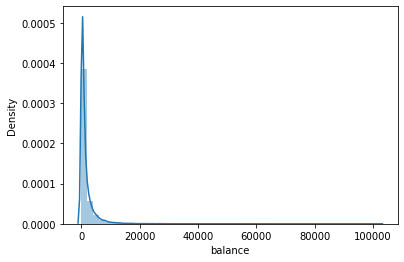

In [ ]:
sns.distplot(final["balance"])

In [ ]:
#cancel
def configure_plotly_browser_state():
  import IPython
  display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>
        <script>
          requirejs.config({
            paths: {
              base: '/static/base',
              plotly: 'https://cdn.plot.ly/plotly-1.5.1.min.js?noext',
            },
          });
        </script>
        '''))

In [ ]:
#cancel
from plotly import tools
import plotly as py
import plotly.figure_factory as ff
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=True)
# Inspired from Randy Lao's HR Analytics

suscribed_df = data.loc[data["term_deposit_subscribed"] == 1.0]

occupations = data["job_type"].unique().tolist()

# Sort the balance by jobs
management = suscribed_df["customer_age"].loc[suscribed_df["job_type"] == "management"].values
technician = suscribed_df["customer_age"].loc[suscribed_df["job_type"] == "technician"].values
services = suscribed_df["customer_age"].loc[suscribed_df["job_type"] == "services"].values
retired = suscribed_df["customer_age"].loc[suscribed_df["job_type"] == "retired"].values
blue_collar = suscribed_df["customer_age"].loc[suscribed_df["job_type"] == "blue-collar"].values
unemployed = suscribed_df["customer_age"].loc[suscribed_df["job_type"] == "unemployed"].values
entrepreneur = suscribed_df["customer_age"].loc[suscribed_df["job_type"] == "entrepreneur"].values
housemaid = suscribed_df["customer_age"].loc[suscribed_df["job_type"] == "housemaid"].values
self_employed = suscribed_df["customer_age"].loc[suscribed_df["job_type"] == "self-employed"].values
student = suscribed_df["customer_age"].loc[suscribed_df["job_type"] == "student"].values



ages = [management, technician, services, retired, blue_collar, unemployed, 
         entrepreneur, housemaid, self_employed, student]

colors = ['rgba(93, 164, 214, 0.5)', 'rgba(255, 144, 14, 0.5)',
          'rgba(44, 160, 101, 0.5)', 'rgba(255, 65, 54, 0.5)', 
          'rgba(207, 114, 255, 0.5)', 'rgba(127, 96, 0, 0.5)',
         'rgba(229, 126, 56, 0.5)', 'rgba(229, 56, 56, 0.5)',
         'rgba(174, 229, 56, 0.5)', 'rgba(229, 56, 56, 0.5)']

traces = []

for xd, yd, cls in zip(occupations, ages, colors):
        traces.append(go.Box(
            y=yd,
            name=xd,
            boxpoints='all',
            jitter=0.5,
            whiskerwidth=0.2,
            fillcolor=cls,
            marker=dict(
                size=2,
            ),
            line=dict(width=1),
        ))

layout = go.Layout(
    title='Distribution of Ages by Occupation',
    yaxis=dict(
        autorange=True,
        showgrid=True,
        zeroline=True,
        dtick=5,
        gridcolor='rgb(255, 255, 255)',
        gridwidth=1,
        zerolinecolor='rgb(255, 255, 255)',
        zerolinewidth=2,
    ),
    margin=dict(
        l=40,
        r=30,
        b=80,
        t=100,
    ),
    paper_bgcolor='rgb(224,255,246)',
    plot_bgcolor='rgb(251,251,251)',
    showlegend=False
)
configure_plotly_browser_state()

init_notebook_mode(connected=False)
fig = go.Figure(data=traces, layout=layout)
iplot(fig)

In [ ]:
#cancel
import plotly.express as px
fig = px.box(final, x="job_type", y="balance")
print("Median of balance: ", final['balance'].median())
configure_plotly_browser_state()
init_notebook_mode(connected=False)
fig.show()

Median of balance:  607.0


In [ ]:
data.loc[(data['balance']<0) & (data['job_type']=='retired')]

,id,customer_age,job_type,marital,education,default,balance,housing_loan,personal_loan,communication_type,day_of_month,month,last_contact_duration,num_contacts_in_campaign,days_since_prev_campaign_contact,num_contacts_prev_campaign,prev_campaign_outcome,term_deposit_subscribed,source,balance_status
19,id_32668,53.0,retired,divorced,secondary,yes,-204.0,no,yes,unknown,6,jun,176.0,1.0,NaN,0,unknown,0.0,train,negative
243,id_1029,61.0,retired,married,tertiary,no,-5.0,no,no,cellular,25,aug,106.0,3.0,NaN,0,unknown,0.0,train,negative
267,id_20716,54.0,retired,divorced,secondary,no,-57.0,no,yes,cellular,15,jul,353.0,10.0,NaN,0,unknown,0.0,train,negative
406,id_41371,59.0,retired,married,primary,no,-3.0,no,no,unknown,18,jun,92.0,1.0,NaN,0,unknown,0.0,train,negative
485,id_41284,55.0,retired,married,primary,no,-2.0,no,no,cellular,30,jan,122.0,4.0,NaN,0,unknown,0.0,train,negative
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
44832,id_33671,55.0,retired,divorced,secondary,no,-667.0,yes,no,unknown,27,may,233.0,2.0,NaN,0,unknown,NaN,test,negative
44894,id_26003,57.0,retired,divorced,primary,no,-140.0,yes,yes,unknown,8,may,106.0,4.0,NaN,0,unknown,NaN,test,negative
44962,id_36399,56.0,retired,divorced,primary,no,-111.0,no,yes,unknown,4,jul,188.0,1.0,NaN,0,unknown,NaN,test,negative
44984,id_17886,57.0,retired,divorced,secondary,no,-659.0,yes,no,cellular,13,may,226.0,1.0,351.0,2,failure,NaN,test,negative


In [1]:
# Feature Engineering
#have to check
df = data
df['balance_status'] = np.nan
lst = [df]

print(lst)
for fet in lst:
  fet.loc[fet['balance']<0, "balance_status"] = "negative"
  fet.loc[(fet['balance']>=0) & (fet['balance']<=20000), "balance_status"] = 'low'
  fet.loc[(fet['balance']>20000) & (fet['balance']<=40000), "balance_status"] = 'medium'
  fet.loc[(fet['balance']>40000) & (fet['balance']<60000), "balance_status"] = 'high'
  fet.loc[fet['balance']>60000, "balance_status"] = 'very high'

neg = df["balance"].loc[df["balance_status"] == "negative"].values.tolist()
low = df["balance"].loc[df["balance_status"] == "low"].values.tolist()
med = df["balance"].loc[df["balance_status"] == "medium"].values.tolist()
high = df["balance"].loc[df["balance_status"] == "high"].values.tolist()
vhigh = df["balance"].loc[df["balance_status"] == "very high"].values.tolist()

# Average balance of jobs
job_balance = df.groupby(['job_type', 'balance_status'])['balance'].mean()

neg_plot = go.Barpolar(
    r=[-2089.0, -876.0, -208.0, -1089.0, -233.0, -270.0, -271.0, 0, -276.0, -134.5],
    text=["blue-collar", "entrepreneur", "housemaid", "management", "retired", "self-employed",
         "services", "student", "technician", "unemployed"],
    name='Negative Balance',
    marker=dict(
        color='rgb(246, 46, 46)'
    )
)
low_plot = go.Barpolar(
    r=[3190.5, 2830.0, 2120.0, 3130.0, 4090.0, 2740.5, 3080.5, 2530.0, 3160.0, 3300.0],
    text=["blue-collar", "entrepreneur", "housemaid", "management", "retired", "self-employed",
         "services", "student", "technician", "unemployed"],
    name='Low Balance',
    marker=dict(
        color='rgb(246, 97, 46)'
    )
)
med_plot = go.Barpolar(
    r=[21280.5, 26860.0, 22900.0, 23660.0, 25790.0, 22930.5, 20050.5, 24880.0, 23620.0, 19760.0],
    text=["blue-collar", "entrepreneur", "housemaid", "management", "retired", "self-employed",
         "services", "student", "technician", "unemployed"],
    name='Medium Balance',
    marker=dict(
        color='rgb(246, 179, 46)'
    )
)
high_plot = go.Barpolar(
    r=[44247.5, 46138.5, 50278.5, 52956.0, 54723.0, 56159.0, 57223.0, 58557.0, 59063.0, 59107.5],
    text=["blue-collar", "entrepreneur", "housemaid", "management", "retired", "self-employed",
         "services", "student", "technician", "unemployed"],
    name='High Balance',
    marker=dict(
        color='rgb(46, 246, 78)'
    )
)
vhigh_plot = go.Barpolar(
    r=[60247.5, 61138.5, 65278.5, 68956.0, 70723.0, 77159.0, 80223.0, 81557.0, 85063.0, 90107.5],
    text=["blue-collar", "entrepreneur", "housemaid", "management", "retired", "self-employed",
         "services", "student", "technician", "unemployed"],
    name='High Balance',
    marker=dict(
        color='rgb(46, 246, 78)'
    )
)
df_1 = [neg_plot, low_plot, high_plot, vhigh_plot]
layout = go.Layout(
    title='Mean Balance in Account<br> <i> by Job Occupation</i>',
    font=dict(
        size=12
    ),
    legend=dict(
        font=dict(
            size=16
        )
    ),
    radialaxis=dict(
        ticksuffix='%'
    ),
    orientation=270
)
configure_plotly_browser_state()
init_notebook_mode(connected=False)
fig = go.Figure(data=df_1, layout=layout)
iplot(fig, filename='polar-area-chart')

NameError: name 'data' is not defined

In [ ]:
data.loc[(data["term_deposit_subscribed"]==1.0) & (data["marital"]=="divorced") & (data["balance"]<0)]

,id,customer_age,job_type,marital,education,default,balance,housing_loan,personal_loan,communication_type,day_of_month,month,last_contact_duration,num_contacts_in_campaign,days_since_prev_campaign_contact,num_contacts_prev_campaign,prev_campaign_outcome,term_deposit_subscribed,source,balance_status
378,id_19867,47.0,technician,divorced,secondary,no,-4.0,no,no,cellular,29,sep,165.0,1.0,120.0,2,failure,1.0,train,negative
2431,id_914,32.0,blue-collar,divorced,unknown,yes,-277.0,yes,yes,cellular,17,apr,698.0,2.0,329.0,2,failure,1.0,train,negative
2818,id_26474,30.0,admin.,divorced,secondary,no,-239.0,no,yes,unknown,27,jun,849.0,2.0,NaN,0,unknown,1.0,train,negative
4570,id_5608,57.0,retired,divorced,secondary,no,-635.0,yes,no,cellular,15,may,568.0,1.0,NaN,0,unknown,1.0,train,negative
4588,id_24226,57.0,blue-collar,divorced,primary,no,-6.0,yes,yes,cellular,8,may,738.0,1.0,NaN,0,unknown,1.0,train,negative
5300,id_42707,42.0,services,divorced,secondary,no,-368.0,yes,no,cellular,5,may,890.0,1.0,NaN,0,unknown,1.0,train,negative
5647,id_10858,43.0,blue-collar,divorced,primary,no,-212.0,no,no,cellular,15,jul,882.0,2.0,NaN,0,unknown,1.0,train,negative
6715,id_27649,37.0,management,divorced,tertiary,no,-44.0,yes,no,cellular,14,may,660.0,2.0,NaN,0,unknown,1.0,train,negative
8020,id_36467,32.0,blue-collar,divorced,secondary,no,-3.0,yes,yes,cellular,18,jul,909.0,4.0,NaN,0,unknown,1.0,train,negative
9805,id_40357,48.0,technician,divorced,secondary,no,-59.0,yes,yes,cellular,13,may,698.0,2.0,292.0,1,failure,1.0,train,negative


In [ ]:
#cancel
vals = data['marital'].value_counts().tolist()
labels = ['married', 'divorced', 'single']

frame = [go.Bar(
            x=labels,
            y=vals,
    marker=dict(
    color="#ff0000")
    )]

layout = go.Layout(
    title="Count of Marital Status",
)

fig = go.Figure(data=frame, layout=layout)
configure_plotly_browser_state()
init_notebook_mode(connected=False)
iplot(fig, filename='basic-bar')

In [ ]:
#cancel
fig = ff.create_facet_grid(
    data,
    x='customer_age',
    y='balance',
    color_name='marital',
    show_boxes=False,
    marker={'size': 10, 'opacity': 1.0}
)
configure_plotly_browser_state()
init_notebook_mode(connected=False)
iplot(fig, filename='facet - custom colormap')

In [ ]:
#cancel
fig = ff.create_facet_grid(
    data,
    y='balance',
    facet_row='marital',
    facet_col='term_deposit_subscribed',
    trace_type='box',
)
configure_plotly_browser_state()
init_notebook_mode(connected=False)
iplot(fig, filename='facet - box traces')

Out of 1500 people, 930 of the Unknown Education entries do not invest in term deposit subscription

In [ ]:
final.loc[(final['education']=="unknown") & (final['term_deposit_subscribed']==0.0)]

,id,customer_age,job_type,marital,education,default,balance,housing_loan,personal_loan,communication_type,day_of_month,month,last_contact_duration,num_contacts_in_campaign,days_since_prev_campaign_contact,num_contacts_prev_campaign,prev_campaign_outcome,term_deposit_subscribed,source
101,id_42873,46.0,blue-collar,married,unknown,no,388.0,no,no,unknown,6,jun,354.0,4.0,NaN,0,unknown,0.0,train
110,id_32123,53.0,admin.,married,unknown,no,214.0,no,no,telephone,17,nov,116.0,2.0,NaN,0,unknown,0.0,train
140,id_19058,47.0,blue-collar,married,unknown,no,3111.0,no,no,cellular,6,aug,187.0,2.0,NaN,0,unknown,0.0,train
221,id_20621,35.0,student,single,unknown,no,39.0,yes,no,unknown,29,may,707.0,1.0,NaN,0,unknown,0.0,train
249,id_24053,41.0,blue-collar,divorced,unknown,no,536.0,no,no,unknown,16,may,157.0,2.0,NaN,0,unknown,0.0,train
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
31479,id_7989,44.0,management,married,unknown,no,2298.0,no,no,unknown,5,jun,52.0,2.0,NaN,0,unknown,0.0,train
31553,id_45090,41.0,blue-collar,married,unknown,no,728.0,yes,no,telephone,20,apr,24.0,1.0,339.0,1,failure,0.0,train
31566,id_39390,31.0,student,single,unknown,no,2325.0,no,no,cellular,9,nov,588.0,2.0,99.0,5,failure,0.0,train
31588,id_22357,55.0,housemaid,divorced,unknown,no,598.0,no,no,telephone,31,jul,90.0,2.0,NaN,0,unknown,0.0,train


In [ ]:
print(final.shape)
final = final.drop(final.loc[final['education']=="unknown"].index)
final.shape

(38926, 19)


(37394, 19)

In [ ]:
numeric_df = data[num_cols]
numeric_df.corr()

,customer_age,balance,day_of_month,last_contact_duration,num_contacts_in_campaign,days_since_prev_campaign_contact,num_contacts_prev_campaign
customer_age,1.000000,0.094211,-0.009988,-0.003388,0.005625,-0.109330,0.000371
balance,0.094211,1.000000,0.003783,0.021181,-0.014046,-0.115305,0.016136
day_of_month,-0.009988,0.003783,1.000000,-0.030950,0.162403,-0.090095,-0.051710
last_contact_duration,-0.003388,0.021181,-0.030950,1.000000,-0.085595,-0.026314,0.000428
num_contacts_in_campaign,0.005625,-0.014046,0.162403,-0.085595,1.000000,0.052005,-0.032902
days_since_prev_campaign_contact,-0.109330,-0.115305,-0.090095,-0.026314,0.052005,1.000000,-0.021885
num_contacts_prev_campaign,0.000371,0.016136,-0.051710,0.000428,-0.032902,-0.021885,1.000000


# Handling Categorical Features

In [ ]:
final = pd.get_dummies(final, columns=cat_cols)
final.head()

,id,customer_age,balance,day_of_month,last_contact_duration,num_contacts_in_campaign,days_since_prev_campaign_contact,num_contacts_prev_campaign,term_deposit_subscribed,source,job_type_admin.,job_type_blue-collar,job_type_entrepreneur,job_type_housemaid,job_type_management,job_type_retired,job_type_self-employed,job_type_services,job_type_student,job_type_technician,job_type_unemployed,marital_0,marital_divorced,marital_married,marital_single,education_primary,education_secondary,education_tertiary,default_no,default_yes,housing_loan_no,housing_loan_yes,personal_loan_0,personal_loan_no,personal_loan_yes,communication_type_cellular,communication_type_telephone,communication_type_unknown,month_apr,month_aug,month_dec,month_feb,month_jan,month_jul,month_jun,month_mar,month_may,month_nov,month_oct,month_sep,prev_campaign_outcome_failure,prev_campaign_outcome_other,prev_campaign_outcome_success,prev_campaign_outcome_unknown
0,id_43823,28.0,285.0,26,303.0,4.0,0.0,0,0.0,train,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,1,1,0,0,1,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1
1,id_32289,34.0,934.0,18,143.0,2.0,132.0,1,0.0,train,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,1,0,1,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0
2,id_10523,46.0,656.0,5,101.0,4.0,0.0,0,0.0,train,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,1,0,0,1,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1
3,id_43951,34.0,2.0,20,127.0,3.0,0.0,0,0.0,train,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,1,0,1,0,0,1,0,1,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1
4,id_40992,41.0,1352.0,13,49.0,2.0,0.0,0,0.0,train,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,0,1,0,1,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1


In [ ]:
# Remaining null values to be filled with zero
final = final.fillna(0)

In [ ]:
final_test = final[final['source']=='test']
final_train = final[final['source']=='train']

In [ ]:
X = final_train.drop(columns=['source', 'term_deposit_subscribed', 'id'], axis=1)
y = final_train['term_deposit_subscribed']

In [ ]:
id_test = final_test['id'] # have to check why
final_test = final_test.drop(columns=['source', 'term_deposit_subscribed', 'id'], axis=1)

In [ ]:
# Baseline Modelling
import time


from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler, LabelEncoder
 
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn import tree
from sklearn.neural_network import MLPClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.gaussian_process.kernels import RBF
from sklearn.ensemble import RandomForestClassifier
from sklearn.naive_bayes import GaussianNB


dict_classifiers = {
    "Logistic Regression": LogisticRegression(),
    "Nearest Neighbors": KNeighborsClassifier(),
    "Linear SVM": SVC(),
    "Gradient Boosting Classifier": GradientBoostingClassifier(),
    "Decision Tree": tree.DecisionTreeClassifier(),
    "Random Forest": RandomForestClassifier(n_estimators=18),
    "Neural Net": MLPClassifier(alpha=1),
    "Naive Bayes": GaussianNB()
}

In [ ]:
no_classifiers = len(dict_classifiers.keys())

def batch_classify(X_train, Y_train, X_test, Y_test, verbose = True):
    df_results = pd.DataFrame(data=np.zeros(shape=(no_classifiers,4)), columns = ['classifier', 'train_score', 'test-score', 'training_time'])
    count = 0
    for key, classifier in dict_classifiers.items():
        t_start = time.clock()
        classifier.fit(X_train, Y_train)
        t_end = time.clock()
        t_diff = t_end - t_start
        train_score = classifier.score(X_train, Y_train)
        test_score = classifier.score(X_test, Y_test)
        df_results.loc[count,'classifier'] = key
        df_results.loc[count,'train_score'] = train_score
        df_results.loc[count, 'test_score'] = test_score
        df_results.loc[count,'training_time'] = t_diff
        if verbose:
            print("trained {c} in {f:.2f} s".format(c=key, f=t_diff))
        count+=1
    return df_results

In [ ]:
X_train, X_test, Y_train, Y_test = train_test_split(X, y, test_size=0.30, random_state=0)
X_tr, X_val, Y_tr, Y_val = train_test_split(X_train, Y_train, test_size=0.30, random_state=0)

In [ ]:
df_results = batch_classify(X_train, Y_train, X_test, Y_test)
print(df_results.sort_values(by='train_score', ascending=False))

trained Logistic Regression in 0.81 s
trained Nearest Neighbors in 0.29 s
trained Linear SVM in 12.53 s
trained Gradient Boosting Classifier in 3.37 s
trained Decision Tree in 0.18 s
trained Random Forest in 0.40 s
trained Neural Net in 4.19 s
trained Naive Bayes in 0.04 s
                     classifier  train_score  ...  training_time  test_score
4                 Decision Tree     1.000000  ...       0.177635    0.894717
5                 Random Forest     0.997708  ...       0.396488    0.910121
3  Gradient Boosting Classifier     0.917658  ...       3.373094    0.918141
1             Nearest Neighbors     0.910128  ...       0.292962    0.890006
0           Logistic Regression     0.893867  ...       0.810553    0.904392
2                    Linear SVM     0.883062  ...      12.526527    0.894335
6                    Neural Net     0.882899  ...       4.192654    0.894335
7                   Naive Bayes     0.859708  ...       0.040589    0.870146

[8 rows x 5 columns]


In [ ]:
from imblearn.combine import SMOTEENN
smote = SMOTEENN()
X_tr, Y_tr = smote.fit_resample(X_tr, Y_tr)
X_val, Y_val = smote.fit_resample(X_val, Y_val)

print(X_tr.shape)
print(Y_tr.shape)

(17118, 51)
(17118,)


In [ ]:
df_results = batch_classify(X_tr, Y_tr, X_val, Y_val)
print(df_results.sort_values(by='train_score', ascending=False))

trained Logistic Regression in 0.82 s
trained Nearest Neighbors in 0.28 s
trained Linear SVM in 17.28 s
trained Gradient Boosting Classifier in 6.82 s
trained Decision Tree in 0.31 s
trained Random Forest in 0.42 s
trained Neural Net in 6.47 s
trained Naive Bayes in 0.03 s
                     classifier  train_score  ...  training_time  test_score
4                 Decision Tree     1.000000  ...       0.312414    0.942541
5                 Random Forest     0.999416  ...       0.424156    0.963559
1             Nearest Neighbors     0.989251  ...       0.279135    0.808653
3  Gradient Boosting Classifier     0.976341  ...       6.816693    0.967654
6                    Neural Net     0.902091  ...       6.470164    0.900778
0           Logistic Regression     0.898878  ...       0.818959    0.897502
7                   Naive Bayes     0.874226  ...       0.032394    0.880306
2                    Linear SVM     0.821767  ...      17.275742    0.823939

[8 rows x 5 columns]


Cross Val Prob vals: [[8.83136530e-01 1.16863470e-01]
 [9.93681563e-01 6.31843732e-03]
 [6.64259194e-01 3.35740806e-01]
 ...
 [7.40549169e-02 9.25945083e-01]
 [5.75340123e-07 9.99999425e-01]
 [1.89957800e-05 9.99981004e-01]]
0.5 For CV Data AUC Score is:  0.9757828629028791 and for Train Data AUC Score is:  0.9808929782554601
Cross Val Prob vals: [[8.46719835e-01 1.53280165e-01]
 [9.90469129e-01 9.53087114e-03]
 [6.42881999e-01 3.57118001e-01]
 ...
 [9.33948098e-02 9.06605190e-01]
 [1.61643708e-06 9.99998384e-01]
 [1.78601523e-04 9.99821398e-01]]
0.1 For CV Data AUC Score is:  0.9755911357588498 and for Train Data AUC Score is:  0.9802977404807381
Cross Val Prob vals: [[8.15168671e-01 1.84831329e-01]
 [9.87492364e-01 1.25076358e-02]
 [6.27695169e-01 3.72304831e-01]
 ...
 [1.08967670e-01 8.91032330e-01]
 [3.30166391e-06 9.99996698e-01]
 [6.31095812e-04 9.99368904e-01]]
0.05 For CV Data AUC Score is:  0.9752144244315357 and for Train Data AUC Score is:  0.9795339249466821
Cross Val Prob 

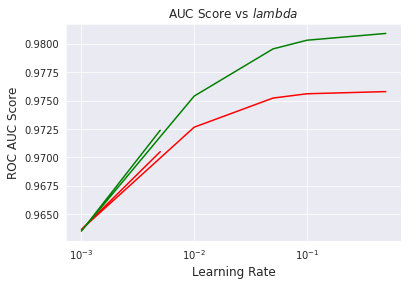

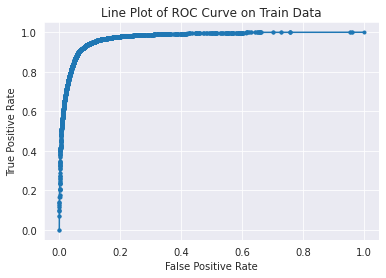

In [ ]:
from sklearn.linear_model import LogisticRegression

def logistic_l2(X_train, X_cv, Y_train, Y_cv):
    best_lr = 0
    max_roc_auc = -1
    pred_cv = []
    pred_train = []
    c = [0.5, 0.1, 0.05, 0.01, 0.001, 0.005]
    for i in c[-6:]:
        lr_clf = LogisticRegression(C=i, penalty='l2')
        lr_clf.fit(X_train, Y_train)
        probs = lr_clf.predict_proba(X_cv)
        prob = lr_clf.predict_proba(X_train)
        print("Cross Val Prob vals:", probs)
        probs = probs[:, 1]
        prob = prob[:, 1]
        auc_score_cv = roc_auc_score(Y_cv, probs)
        auc_score_train = roc_auc_score(Y_train, prob)
        print(i, "For CV Data AUC Score is: ", auc_score_cv, "and for Train Data AUC Score is: ", auc_score_train)
        pred_cv.append(auc_score_cv)
        pred_train.append(auc_score_train)
        if max_roc_auc < auc_score_cv:
            max_roc_auc = auc_score_cv
            best_c = i
    print(f"\n Best learning rate is {best_c} with highest roc_auc Score is {max_roc_auc}")
    sns.set_style("darkgrid")
    plt.xscale("log")
    plt.plot(c, pred_cv, 'r-', label="CV Data")
    plt.plot(c, pred_train, 'g-', label="Train Data")
    plt.title("AUC Score vs $lambda$")
    plt.xlabel("Learning Rate", fontsize=12)
    plt.ylabel("ROC AUC Score", fontsize=12)
    plt.show()
    
    fpr, tpr, thresholds = roc_curve(Y_train, prob)
    plt.plot(fpr, tpr, marker=".")
    plt.title("Line Plot of ROC Curve on Train Data")
    plt.xlabel("False Positive Rate")
    plt.ylabel("True Positive Rate")
    plt.show()
logistic_l2(X_tr, X_val, Y_tr, Y_val)

In [ ]:
!pip install scikit-plot

AUC Score:  0.9299705527773173
F1 Score Macro:  0.7229174066518936
F1 Score Micro:  0.8349657714586625
hamming loss for data: 0.16503422854133754
Precision recall report for data:
               precision    recall  f1-score   support

         0.0       0.99      0.83      0.90      8458
         1.0       0.39      0.91      0.55      1037

    accuracy                           0.83      9495
   macro avg       0.69      0.87      0.72      9495
weighted avg       0.92      0.83      0.86      9495



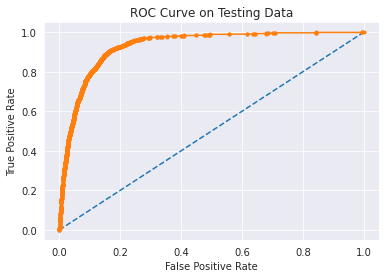

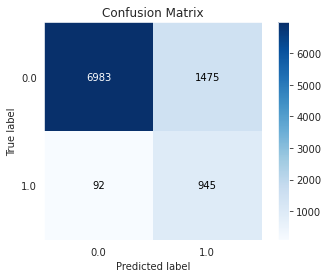

In [ ]:
import scikitplot.metrics as skplt
from sklearn import metrics
def testing_l2(X_train, Y_train, X_test, Y_test, optimal_lr):
    clf = LogisticRegression(C=optimal_lr, penalty='l2')
    clf.fit(X_train, Y_train)
    probs = clf.predict_proba(X_test)
    # Storing the probability values for positive outcomes
    probs = probs[:,1]
    print("AUC Score: ", roc_auc_score(Y_test, probs))
    fpr, tpr, thresholds = roc_curve(Y_test, probs)
    plt.plot([0,1], [0,1], linestyle="--")
    
    # Plot the ROC Curve for the model
    plt.plot(fpr, tpr, marker=".")
    plt.title("ROC Curve on Testing Data")
    plt.ylabel("True Positive Rate")
    plt.xlabel("False Positive Rate")
    plt.show
    prediction = clf.predict(X_test)
    skplt.plot_confusion_matrix(Y_test, prediction)
    print("F1 Score Macro: ", metrics.f1_score(Y_test, prediction, average='macro'))
    print("F1 Score Micro: ", metrics.f1_score(Y_test, prediction, average="micro"))
    print("hamming loss for data:", metrics.hamming_loss(Y_test,prediction))
    print("Precision recall report for data:\n", metrics.classification_report(Y_test, prediction))
testing_l2(X_tr, Y_tr, X_test, Y_test, optimal_lr=0.5)

In [ ]:
from sklearn.tree import DecisionTreeClassifier
"""Bias Variance of decision tree
n elements: low bias
log n: high variance depth of tree
1,2,3,4,5 traverse all of (high bias: underfitted ie that we have not taken all the data)
sol: provide more data to the model
DT is having low bias (root node)

3->1,2
3->4,5
DT is having high variance
Bias: I will rattafy or mug up values (I will revise everything again)
Variance: how spread my data is or how large is my data or how varied it is
1,2,3,4,5
low bias always
Low bias and low variance

ONLY DT=1
set of trees - > Forest

Random Forest -> Low bias Low variance
lets make 5 dtrees -> increase in overall bias of model -> variance low but the tree bias is still low due to inherent structure
Reduce variance of decision tree by some mathematical technique/function
make sure that a get better model
Bias-Variance Tradeoff -> Bias inc -> Var dec or vice versa
1,2
2,3
3,4
4,5
1,4
2,5
"""

from sklearn.model_selection import RandomizedSearchCV

hyperparam_combs = {
    'max_depth': [4, 6, 8, 10, 12, 14, 16],
    'criterion': ['gini', 'entropy'],
    'min_samples_split': [2, 10, 20, 30, 40],
    'max_features': [0.2, 0.4, 0.6, 0.8, 1],
    'max_leaf_nodes': [8, 16, 32, 64, 128,256],
    'class_weight': [{0: 1, 1: 1}, {0: 1, 1: 2}, {0: 1, 1: 3}, {0: 1, 1: 4}, {0: 1, 1: 5}]
}

clf = RandomizedSearchCV(DecisionTreeClassifier(),
                         hyperparam_combs,
                         scoring='f1',
                         random_state=1,
                         n_iter=20)

search = clf.fit(X, y)

search.best_params_

{'class_weight': {0: 1, 1: 3},
 'criterion': 'gini',
 'max_depth': 14,
 'max_features': 0.8,
 'max_leaf_nodes': 64,
 'min_samples_split': 10}

For CV Data AUC Score is:  0.9659630306856318 and for Train Data AUC Score is:  0.9886502193445597

highest roc_auc Score is 0.9659630306856318


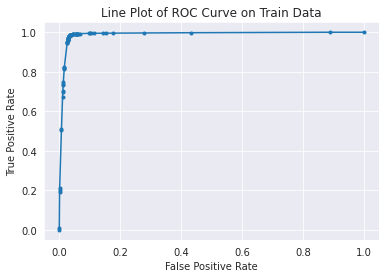

In [ ]:
def decision_tree(X_train, X_cv, Y_train, Y_cv):
    max_roc_auc = -1
    pred_cv = []
    pred_train = []
    clf = DecisionTreeClassifier(class_weight={0: 1, 1: 3}, criterion='gini',
                                        max_depth=14, max_features=0.8, max_leaf_nodes=128,
                                        min_samples_split=20)
    clf.fit(X_train, Y_train)
    probs = clf.predict_proba(X_cv)
    prob = clf.predict_proba(X_train)
    probs = probs[:, 1]
    prob = prob[:, 1]
    auc_score_cv = roc_auc_score(Y_cv, probs)
    auc_score_train = roc_auc_score(Y_train, prob)
    print("For CV Data AUC Score is: ", auc_score_cv, "and for Train Data AUC Score is: ", auc_score_train)
    pred_cv.append(auc_score_cv)
    pred_train.append(auc_score_train)
    if max_roc_auc < auc_score_cv:
          max_roc_auc = auc_score_cv
    print(f"\nhighest roc_auc Score is {max_roc_auc}")
    sns.set_style("darkgrid")
    
    fpr, tpr, thresholds = roc_curve(Y_train, prob)
    plt.plot(fpr, tpr, marker=".")
    plt.title("Line Plot of ROC Curve on Train Data")
    plt.xlabel("False Positive Rate")
    plt.ylabel("True Positive Rate")
    plt.show()
decision_tree(X_tr, X_val, Y_tr, Y_val)

AUC Score:  0.902519123934864
F1 Score Macro:  0.7788268462352794
F1 Score Micro:  0.9011058451816746
hamming loss for data: 0.09889415481832543
Precision recall report for data:
               precision    recall  f1-score   support

         0.0       0.96      0.92      0.94      8458
         1.0       0.54      0.72      0.61      1037

    accuracy                           0.90      9495
   macro avg       0.75      0.82      0.78      9495
weighted avg       0.92      0.90      0.91      9495



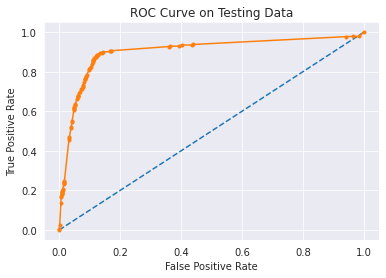

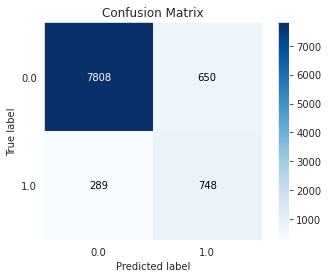

In [ ]:
import scikitplot.metrics as skplt
from sklearn import metrics
def testing_l2(X_train, Y_train, X_test, Y_test, optimal_lr):
    clf = DecisionTreeClassifier(class_weight={0: 1, 1: 2}, criterion='gini',
                                        max_depth=14, max_features=0.8, max_leaf_nodes=128,
                                        min_samples_split=20)
    clf.fit(X_train, Y_train)
    probs = clf.predict_proba(X_test)
    # Storing the probability values for positive outcomes
    probs = probs[:,1]
    print("AUC Score: ", roc_auc_score(Y_test, probs))
    fpr, tpr, thresholds = roc_curve(Y_test, probs)
    plt.plot([0,1], [0,1], linestyle="--")
    
    # Plot the ROC Curve for the model
    plt.plot(fpr, tpr, marker=".")
    plt.title("ROC Curve on Testing Data")
    plt.ylabel("True Positive Rate")
    plt.xlabel("False Positive Rate")
    plt.show
    prediction = clf.predict(X_test)
    skplt.plot_confusion_matrix(Y_test, prediction)
    print("F1 Score Macro: ", metrics.f1_score(Y_test, prediction, average='macro'))
    print("F1 Score Micro: ", metrics.f1_score(Y_test, prediction, average="micro"))
    print("hamming loss for data:", metrics.hamming_loss(Y_test,prediction))
    print("Precision recall report for data:\n", metrics.classification_report(Y_test, prediction))
testing_l2(X_train, Y_train, X_test, Y_test, optimal_lr=0.5)

In [ ]:
from sklearn.model_selection import RandomizedSearchCV

hyperparam_combs = {
    'n_estimators': [10, 20, 50, 100, 200],
    'learning_rate': [0.1, 0.5, 0.01, 0.05, 0.005],
    'min_samples_split': [2, 10, 20, 30, 40],
    'min_samples_leaf': [1, 2, 3, 4, 5],
    'max_depth': [2,3,5,8,10,20],
    'max_leaf_nodes': [8, 16, 32, 64, 128,256]
}

clf = RandomizedSearchCV(GradientBoostingClassifier(),
                         hyperparam_combs,
                         scoring='f1',
                         random_state=1,
                         n_iter=20)

search = clf.fit(X, y)

search.best_params_

{'learning_rate': 0.1,
 'max_depth': 10,
 'max_leaf_nodes': 64,
 'min_samples_leaf': 4,
 'min_samples_split': 20,
 'n_estimators': 50}

For CV Data AUC Score is:  0.9959938884679123 and for Train Data AUC Score is:  0.9997387479275075

highest roc_auc Score is 0.9959938884679123


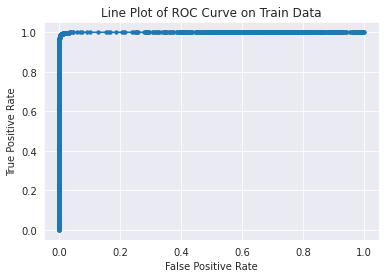

In [ ]:
def Gradient_Boosting(X_train, X_cv, Y_train, Y_cv):
  pred_cv = []
  pred_train = []
  max_roc_auc = -1
  clf = GradientBoostingClassifier(learning_rate=0.1, max_depth=10, max_leaf_nodes=64,
                                   min_samples_leaf=4, min_samples_split=20,
                                   n_estimators=50)
  clf.fit(X_train, Y_train)
  probs = clf.predict_proba(X_train)
  prob = clf.predict_proba(X_cv)
  probs = probs[:, 1]
  prob = prob[:, 1]
  auc_score_cv = roc_auc_score(Y_cv, prob)
  auc_score_train = roc_auc_score(Y_train, probs)
  print("For CV Data AUC Score is: ", auc_score_cv, "and for Train Data AUC Score is: ", auc_score_train)
  pred_cv.append(auc_score_cv)
  pred_train.append(auc_score_train)
  if max_roc_auc < auc_score_cv:
    max_roc_auc = auc_score_cv
  print(f"\nhighest roc_auc Score is {max_roc_auc}")
  sns.set_style("darkgrid")
  fpr, tpr, thresholds = roc_curve(Y_train, probs)
  plt.plot(fpr, tpr, marker=".")
  plt.title("Line Plot of ROC Curve on Train Data")
  plt.xlabel("False Positive Rate")
  plt.ylabel("True Positive Rate")
  plt.show()
Gradient_Boosting(X_tr, X_val, Y_tr, Y_val)

AUC Score:  0.9481341165373236
F1 Score Macro:  0.7645854145854145
F1 Score Micro:  0.9167409293443667
hamming loss for data: 0.08325907065563336
Precision recall report for data:
               precision    recall  f1-score   support

         0.0       0.95      0.96      0.95      7025
         1.0       0.62      0.53      0.58       830

    accuracy                           0.92      7855
   macro avg       0.78      0.75      0.76      7855
weighted avg       0.91      0.92      0.91      7855



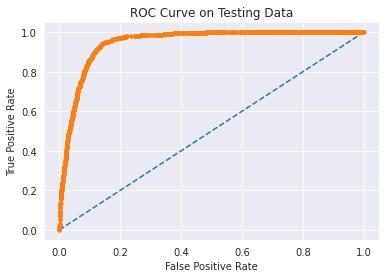

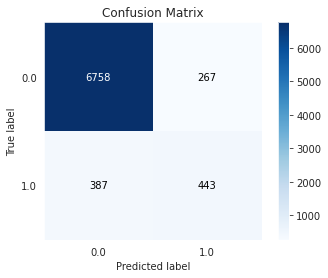

In [ ]:
import scikitplot.metrics as skplt
from sklearn import metrics
def testing_GBC(X_train, Y_train, X_test, Y_test, optimal_lr):
    clf = GradientBoostingClassifier(learning_rate=optimal_lr, max_depth=10, max_leaf_nodes=64,
                                   min_samples_leaf=4, min_samples_split=20,
                                   n_estimators=50)
    clf.fit(X_train, Y_train)
    probs = clf.predict_proba(X_test)
    # Storing the probability values for positive outcomes
    probs = probs[:, 1]
    print("AUC Score: ", roc_auc_score(Y_test, probs))
    fpr, tpr, thresholds = roc_curve(Y_test, probs)
    plt.plot([0,1], [0,1], linestyle="--")
    
    # Plot the ROC Curve for the model
    plt.plot(fpr, tpr, marker=".")
    plt.title("ROC Curve on Testing Data")
    plt.ylabel("True Positive Rate")
    plt.xlabel("False Positive Rate")
    plt.show
    prediction = clf.predict(X_test)
    skplt.plot_confusion_matrix(Y_test, prediction)
    print("F1 Score Macro: ", metrics.f1_score(Y_test, prediction, average='macro'))
    print("F1 Score Micro: ", metrics.f1_score(Y_test, prediction, average="micro"))
    print("hamming loss for data:", metrics.hamming_loss(Y_test,prediction))
    print("Precision recall report for data:\n", metrics.classification_report(Y_test, prediction))
testing_GBC(X_train, Y_train, X_test, Y_test, optimal_lr=0.1)

Cross Val Prob vals: [[1.00000000e+000 8.27428063e-027]
 [1.00000000e+000 4.03740222e-078]
 [1.96787314e-067 1.00000000e+000]
 ...
 [1.00000000e+000 2.09986965e-150]
 [5.22405018e-070 1.00000000e+000]
 [1.54717238e-032 1.00000000e+000]]
0.5 For CV Data AUC Score is:  0.650078286672378 and for Train Data AUC Score is:  0.6322728802208352
Cross Val Prob vals: [[1.00000000e+000 8.27049306e-027]
 [1.00000000e+000 4.04502455e-078]
 [1.96837662e-067 1.00000000e+000]
 ...
 [1.00000000e+000 2.11236961e-150]
 [5.19680673e-070 1.00000000e+000]
 [1.54998649e-032 1.00000000e+000]]
0.1 For CV Data AUC Score is:  0.6500793359911077 and for Train Data AUC Score is:  0.6322741956409292
Cross Val Prob vals: [[1.00000000e+000 8.27001976e-027]
 [1.00000000e+000 4.04599148e-078]
 [1.96843956e-067 1.00000000e+000]
 ...
 [1.00000000e+000 2.11394614e-150]
 [5.19339661e-070 1.00000000e+000]
 [1.55033853e-032 1.00000000e+000]]
0.05 For CV Data AUC Score is:  0.6500794858937835 and for Train Data AUC Score is: 

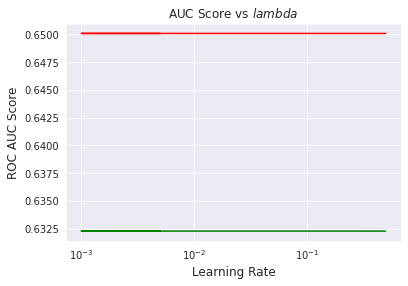

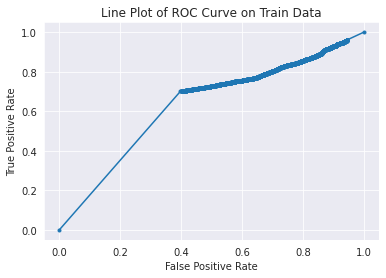

In [ ]:
from sklearn.naive_bayes import MultinomialNB
def Naive_Bayes(X_train, X_cv, Y_train, Y_cv):
    best_lr = 0
    max_roc_auc = -1
    pred_cv = []
    pred_train = []
    c = [0.5, 0.1, 0.05, 0.01, 0.001, 0.005]
    for i in c[-6:]:
        clf = MultinomialNB(alpha=i)
        clf.fit(X_train, Y_train)
        probs = clf.predict_proba(X_cv)
        prob = clf.predict_proba(X_train)
        print("Cross Val Prob vals:", probs)
        probs = probs[:, 1]
        prob = prob[:, 1]
        auc_score_cv = roc_auc_score(Y_cv, probs)
        auc_score_train = roc_auc_score(Y_train, prob)
        print(i, "For CV Data AUC Score is: ", auc_score_cv, "and for Train Data AUC Score is: ", auc_score_train)
        pred_cv.append(auc_score_cv)
        pred_train.append(auc_score_train)
        if max_roc_auc < auc_score_cv:
            max_roc_auc = auc_score_cv
            best_c = i
    print(f"\n Best learning rate is {best_c} with highest roc_auc Score is {max_roc_auc}")
    sns.set_style("darkgrid")
    plt.xscale("log")
    plt.plot(c, pred_cv, 'r-', label="CV Data")
    plt.plot(c, pred_train, 'g-', label="Train Data")
    plt.title("AUC Score vs $lambda$")
    plt.xlabel("Learning Rate", fontsize=12)
    plt.ylabel("ROC AUC Score", fontsize=12)
    plt.show()
    
    fpr, tpr, thresholds = roc_curve(Y_train, prob)
    plt.plot(fpr, tpr, marker=".")
    plt.title("Line Plot of ROC Curve on Train Data")
    plt.xlabel("False Positive Rate")
    plt.ylabel("True Positive Rate")
    plt.show()
Naive_Bayes(X_tr, X_val, Y_tr, Y_val)

AUC Score:  0.6010792779659564
F1 Score Macro:  0.42842624890544023
F1 Score Micro:  0.49929980903882876
hamming loss for data: 0.5007001909611712
Precision recall report for data:
               precision    recall  f1-score   support

         0.0       0.93      0.48      0.63      7025
         1.0       0.14      0.70      0.23       830

    accuracy                           0.50      7855
   macro avg       0.53      0.59      0.43      7855
weighted avg       0.85      0.50      0.59      7855



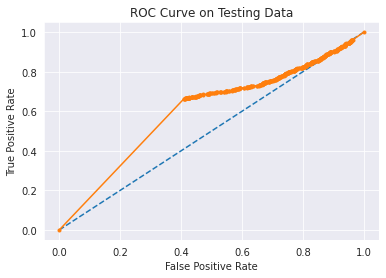

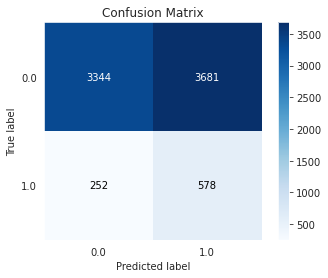

In [ ]:
import scikitplot.metrics as skplt
from sklearn import metrics
def testing_NB(X_train, Y_train, X_test, Y_test, optimal_lr):
    clf = MultinomialNB(alpha=0.005)
    clf.fit(X_train, Y_train)
    probs = clf.predict_proba(X_test)
    # Storing the probability values for positive outcomes
    probs = probs[:, 1]
    print("AUC Score: ", roc_auc_score(Y_test, probs))
    fpr, tpr, thresholds = roc_curve(Y_test, probs)
    plt.plot([0,1], [0,1], linestyle="--")
    
    # Plot the ROC Curve for the model
    plt.plot(fpr, tpr, marker=".")
    plt.title("ROC Curve on Testing Data")
    plt.ylabel("True Positive Rate")
    plt.xlabel("False Positive Rate")
    plt.show
    prediction = clf.predict(X_test)
    skplt.plot_confusion_matrix(Y_test, prediction)
    print("F1 Score Macro: ", metrics.f1_score(Y_test, prediction, average='macro'))
    print("F1 Score Micro: ", metrics.f1_score(Y_test, prediction, average="micro"))
    print("hamming loss for data:", metrics.hamming_loss(Y_test,prediction))
    print("Precision recall report for data:\n", metrics.classification_report(Y_test, prediction))
testing_NB(X_train, Y_train, X_test, Y_test, optimal_lr=0.1)

In [ ]:
test

,id,customer_age,job_type,marital,education,default,balance,housing_loan,personal_loan,communication_type,day_of_month,month,last_contact_duration,num_contacts_in_campaign,days_since_prev_campaign_contact,num_contacts_prev_campaign,prev_campaign_outcome,source
0,id_17231,55.0,retired,married,tertiary,no,7136.0,no,no,cellular,13,aug,90.0,2.0,NaN,0,unknown,test
1,id_34508,24.0,blue-collar,single,secondary,no,179.0,yes,no,cellular,18,may,63.0,2.0,NaN,0,unknown,test
2,id_44504,46.0,technician,divorced,secondary,no,143.0,no,no,cellular,8,jul,208.0,1.0,NaN,0,unknown,test
3,id_174,56.0,housemaid,single,unknown,no,6023.0,no,no,unknown,6,jun,34.0,1.0,NaN,0,unknown,test
4,id_2115,62.0,retired,married,secondary,no,2913.0,no,no,cellular,12,apr,127.0,1.0,188.0,1,success,test
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13559,id_42406,29.0,management,single,tertiary,no,717.0,yes,no,cellular,15,jun,94.0,1.0,NaN,0,unknown,test
13560,id_14483,NaN,blue-collar,married,secondary,no,604.0,yes,no,telephone,10,jul,155.0,1.0,NaN,0,unknown,test
13561,id_43066,45.0,blue-collar,married,primary,no,237.0,yes,no,unknown,16,may,231.0,4.0,NaN,0,unknown,test
13562,id_18375,52.0,admin.,married,primary,no,241.0,yes,no,cellular,13,may,243.0,2.0,299.0,5,failure,test


In [ ]:
def data_preprocessing(df):
  col_id = 'id'
  col_y = 'term_deposit_subscribed'
  src = 'source'
  features = [c for c in train.columns if c not in [col_id, src, col_y]]
  # categorical variables
  cat_cols = data.select_dtypes(include=['object'])
  cat_cols = [c for c in features if c in cat_cols]
  # numerical variables
  num_cols = [n for n in features if n not in cat_cols]
  df = df.fillna(0)
  df[num_cols] = StandardScaler().fit_transform(
  df[num_cols])
  df = pd.get_dummies(df, columns=cat_cols)
  df = df.drop(columns=['source'])
  return df
data_preprocessing(test)

,id,customer_age,balance,day_of_month,last_contact_duration,num_contacts_in_campaign,days_since_prev_campaign_contact,num_contacts_prev_campaign,job_type_admin.,job_type_blue-collar,job_type_entrepreneur,job_type_housemaid,job_type_management,job_type_retired,job_type_self-employed,job_type_services,job_type_student,job_type_technician,job_type_unemployed,job_type_unknown,marital_0,marital_divorced,marital_married,marital_single,education_primary,education_secondary,education_tertiary,education_unknown,default_no,default_yes,housing_loan_no,housing_loan_yes,personal_loan_0,personal_loan_no,personal_loan_yes,communication_type_cellular,communication_type_telephone,communication_type_unknown,month_apr,month_aug,month_dec,month_feb,month_jan,month_jul,month_jun,month_mar,month_may,month_nov,month_oct,month_sep,prev_campaign_outcome_failure,prev_campaign_outcome_other,prev_campaign_outcome_success,prev_campaign_outcome_unknown
0,id_17231,1.274568,2.057701,-0.333855,-0.646394,-0.245503,-0.406325,-0.314336,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,0,1,0,1,0,0,1,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1
1,id_34508,-1.298680,-0.405170,0.267016,-0.749773,-0.245503,-0.406325,-0.314336,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,0,1,0,1,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1
2,id_44504,0.527496,-0.417915,-0.934725,-0.194590,-0.585576,-0.406325,-0.314336,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,1,0,0,1,0,1,0,0,1,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1
3,id_174,1.357576,1.663684,-1.175074,-0.860809,-0.585576,-0.406325,-0.314336,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,1,0,1,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1
4,id_2115,1.855624,0.562702,-0.454029,-0.504726,-0.585576,1.492183,0.253092,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,1,0,0,1,0,1,0,0,1,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13559,id_42406,-0.883640,-0.214711,-0.093506,-0.631078,-0.585576,-0.406325,-0.314336,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,1,0,0,1,0,1,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1
13560,id_14483,-3.290872,-0.254715,-0.694377,-0.397519,-0.585576,-0.406325,-0.314336,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,1,0,0,1,0,1,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1
13561,id_43066,0.444488,-0.384638,0.026668,-0.106526,0.434644,-0.406325,-0.314336,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,1,0,0,1,0,1,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1
13562,id_18375,1.025544,-0.383221,-0.333855,-0.060580,-0.245503,2.613110,2.522806,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,1,0,0,1,0,1,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0


In [ ]:
import pickle
model = GradientBoostingClassifier(learning_rate=0.1, max_depth=10, max_leaf_nodes=64,
                                   min_samples_leaf=4, min_samples_split=20,
                                   n_estimators=50)
pickle.dump(model, open("GB.pkl", 'wb'))
loaded_model = pickle.load(open("GB.pkl", 'rb'))
loaded_model.fit(X_train, Y_train)
result = loaded_model.score(X_test, Y_test)
print(result)

from google.colab import files
files.download('GB.pkl') 

0.9167409293443667


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>